In [19]:
# !pip install scikit-image
import math
import re
import torch
print(torch.__version__)
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")
# 런타임->런타임 다시 시작 후 아래 수행. 
from mmdet.apis import init_detector, inference_detector
import mmcv
import os
import pandas as pd
import numpy as np
import time
from tqdm.notebook import tqdm
pd.set_option('display.max_colwidth', 300)
import matplotlib.pyplot as plt
import cv2
import pycocotools.mask as maskUtils
# 학습과 검증용 image id 데이터들을 추출. 
from sklearn.model_selection import train_test_split
import json
import shutil
from mmdet.datasets.builder import DATASETS
from mmdet.datasets.coco import CocoDataset
from mmcv import Config
from mmdet.datasets import build_dataset
from mmdet.models import build_detector
from mmdet.apis import train_detector
from pycocotools.coco import COCO
from mmdet.apis import set_random_seed
import os.path as osp
import panopticapi
from panopticapi.evaluation import VOID
from panopticapi.utils import id2rgb
import seaborn as sns
pd.options.display.max_columns = None

labels_to_names_seq =  {0:'Crack', 
                        1:'billet', 
                        2:'Shrinkage', 
                        3:'Equiaxed_Area',
                        4:'Scratch',
                        5:'NotQuenching_Profile',
                        6:'Pinhole',
                        7:'Bleeding',
                        8:'Bloom',
                        9:'Bloom_TB_Surface',
                        10:'Bloom_Side_Surface',
                        11:'L_direction'}

def show_image_masks(image_file_name, mask_file_list, cols=5):
    figure, axs = plt.subplots(nrows=1, ncols=cols, figsize=(16, 12))
    for i in range(cols):
        im_name = image_file_name if i ==0 else mask_file_list[i-1]
        im_array = cv2.cvtColor(cv2.imread(im_name), cv2.COLOR_BGR2RGB)
        print('{0:} shape:{1:}'.format('image' if i == 0 else 'mask', im_array.shape))
        axs[i].imshow(im_array)
        axs[i].set_title('image' if i == 0 else 'mask'+str(i))

def get_imagename_list(data_root_dir):
    imagename_list = []
    imageid_list = []
    # data_root_dir 밑에 있는 모든 image id 디렉토리의 서브 디렉토리 중 images 디렉토리 밑에 있는 image 파일 명을 절대 경로로 추출
    # data_root_dir -> image id dir -> images -> image 파일명 
    for dir in sorted(next(os.walk(data_root_dir))[1]):
        subdirs = os.path.join(data_root_dir, dir)
        if 'images' in subdirs:
            image_dir = subdirs
            # print(image_dir)
            for imagename in sorted(next(os.walk(image_dir))[2]):
                # print(imagename.replace('.JPG', '').replace('.jpg', ''))
                imagename_list.append(os.path.join(image_dir, imagename))
                imageid_list.append(int(imagename.replace('.JPG', '').replace('.jpg', '').replace('.png', '')))
    
    return imageid_list, imagename_list

# 특정 image id 디렉토리 밑에 있는 mask 파일명을 절대 경로로 모두 추출.
# image_id dir -> masks -> 여러 mask 파일 명 
def get_maskname_list(data_root_dir, idx):
    mask_dir = os.path.join(data_root_dir, 'masks')
    maskname_list_list = []
    maskname_list = []
    first = []
    second = []
    third = []
    fourth = []
    fifth = []
    sixth = []
    seventh = []
    eighth = []
    ninth = []
    tenth = []
    eleventh = []
    twelfth = []
    for mask_filename in next(os.walk(mask_dir))[2]:
        if 'png' in mask_filename:
            # print(mask_filename)
            image_id = int(re.split('-', mask_filename)[1])
            if idx == image_id:
                if labels_to_names_seq[0] in mask_filename:                    
                    first.append(os.path.join(mask_dir, mask_filename))
                elif labels_to_names_seq[1] in mask_filename:                    
                    second.append(os.path.join(mask_dir, mask_filename))
                elif labels_to_names_seq[2] in mask_filename:                    
                    third.append(os.path.join(mask_dir, mask_filename))
                elif labels_to_names_seq[3] in mask_filename:
                    fourth.append(os.path.join(mask_dir, mask_filename))
                elif labels_to_names_seq[4] in mask_filename:
                    fifth.append(os.path.join(mask_dir, mask_filename))
                elif labels_to_names_seq[5] in mask_filename:
                    sixth.append(os.path.join(mask_dir, mask_filename))
                elif labels_to_names_seq[6] in mask_filename:
                    seventh.append(os.path.join(mask_dir, mask_filename))    
                elif labels_to_names_seq[7] in mask_filename:
                    eighth.append(os.path.join(mask_dir, mask_filename))
                elif labels_to_names_seq[9] in mask_filename:
                    tenth.append(os.path.join(mask_dir, mask_filename))    
                elif labels_to_names_seq[10] in mask_filename:
                    eleventh.append(os.path.join(mask_dir, mask_filename))    
                elif labels_to_names_seq[11] in mask_filename:
                    twelfth.append(os.path.join(mask_dir, mask_filename))
                # bloom은 제일 마지막에 수집
                elif labels_to_names_seq[8] in mask_filename:
                    ninth.append(os.path.join(mask_dir, mask_filename))
          
            else:
                continue      
    maskname_list.append([first, second, third, fourth, fifth, sixth, seventh, eighth, ninth, tenth, eleventh, twelfth])                              
    return maskname_list[0]

def make_meta_df(dataset_dir):
    # 모든 image id들의 list를 가져옴.
    # 모든 image 절대경로들의 list를 가져옴.
    imageid_list, imagename_list = get_imagename_list(dataset_dir)
    # 개별 image당 모든 mask 절대 경로를 가져옴. 각 행이 경로모음list가 됨
    maskname_list_list = []
    for imageid in imageid_list:
        maskname_list = get_maskname_list(dataset_dir, idx=imageid)
        maskname_list_list.append(maskname_list)
    
    print(len(imageid_list), len(imagename_list), len(maskname_list))
    
    
    mata_df = pd.DataFrame({'image_id' : imageid_list,
                            'image_name' : imagename_list,
                            'maskname_list' : maskname_list_list
                            })
    return mata_df

# bounding box 정보를 polygon에서 추출. 
def get_bbox(segm):
    x_min = float('inf')
    y_min = float('inf')
    x_max = 0
    y_max = 0
    # print(segm)
    #segmentation polygon정보로 bounding box 정보 추출. 
    # cv2.boundingRect : contour에 외접하는 똑바로 세워진 사각형 좌표
    x, y, w, h = cv2.boundingRect(segm)
    x_b = x + w
    y_b = y + h
    # 최소 0보다 크고, 무한대 보다는 좌표값이 작아야 함.
    x_min = min(x_min, x)
    y_min = min(y_min, y)
    x_max = max(x_max, x_b)
    y_max = max(y_max, y_b)
        
    # 좌상단 좌표와, width, height 반환. 
    return x_min, y_min, x_max - x_min, y_max - y_min

# https://github.com/open-mmlab/mmdetection/blob/master/mmdet/datasets/pipelines/loading.py def _poly2mask(self, mask_ann, img_h, img_w):
import pycocotools.mask as maskUtils

def check_polygons(mask_filepath, polygons, img_h, img_w):
    try:
        rles = maskUtils.frPyObjects(polygons, img_h, img_w)
        rle = maskUtils.merge(rles)
        # print(rle)
    except Exception as e:
        print('##### 오류 polygon 발생 #####:',  e,polygons)
        print('오류 mask file명:', mask_filepath)
        
# mask image를 기반으로 segmentation polygon과 bbox 정보를 추출하는 로직 함수화
def get_annotation_info(mask_filename):
    
    bboxs = []
    
    # mask_filepath = os.path.join(mask_dir, mask_filename)
    mask_filepath = mask_filename
    # print(mask_filepath)
    mask_array = cv2.imread(mask_filepath)
    mask_array = np.where(mask_array > 0, 255, mask_array)
    contours, hierarchy = cv2.findContours(mask_array[:, :, 0], cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    # 좌표 2개초과인 경우만 좌표수집
    # contour → mask 재변환시 좌표개수가 2보다 작으면 다각형이 안 만들어지므로 문제가 됨
    # chech_polygons를 이용하면 확인가능
    segm = [contour for contour in contours if contour.shape[0] > 2]  
    # polygons = [s.ravel().tolist() for s in contours]
    polygons = [s.ravel().tolist() for s in segm] # 실제 필요코드
    check_polygons(mask_filepath, polygons, mask_array.shape[0], mask_array.shape[1])
    # 만약 polygons가 Null이면 segmentation과 bbox annotation을 None으로 반환.
    if polygons == []:
        return None, None
    # polygons가 Null이 아니면 정상적으로 segmentation과 bbox annotation 반환. 
    else:
        for num in range(len(polygons)):
            xmin, ymin, bwidth, bheight = get_bbox(segm[num])  
            bboxs.append([xmin, ymin, bwidth, bheight])
             
        return polygons, bboxs

# mmdetection config에 맞추기 위해 nucleus 이미지 파일을 별도의 디렉토리로 이동하는 로직 추가 
def convert_bloom_to_coco(data_root_dir, image_ids, out_file, img_copy_dir, meta_df, labels_to_names_seq):
    
    images = []
    annotations = []
    categories = []
    obj_index = 0
    
    # image 정보를 담아서 images list에 추가.
    for index, image_id in enumerate(image_ids):
        
        # image_id_dir = os.path.join(data_root_dir, image_id)
        # image_path = os.path.join(image_id_dir, 'images/' + image_id + '.JPG')
        
        image_path = os.path.join(data_root_dir, 'images/' + str(image_id) + '.jpg')
        print(image_path)
        file_name = str(image_id) + '.jpg'
        height, width = cv2.imread(image_path).shape[0:2]
        # 개별 image의 dict 정보 생성
        image_info = dict(file_name=file_name,
                          height=height,
                          width=width,
                          id=str(image_id))
        # 개별 image dict 정보를 images list에 추가. 
        images.append(image_info)
        
        # 이미지를 특정 디렉토리 밑으로 모일 수 있도록 copy
        shutil.copy(image_path, os.path.join(img_copy_dir, file_name))
        
        # 개별 image에 있는 여러 mask 이미지 파일을 segmentation, bbox로 변환하여 annotation dict 정보 생성.
        mask_dir = os.path.join(data_root_dir, 'masks')
        # mask_filename_list = next(os.walk(mask_dir))[2]
        # 개별 image에 있는 여러 mask 이미지 파일을 기반으로 annotation dict 생성.
        for category_id in range(len(labels_to_names_seq)):
            for maskname_list in meta_df['maskname_list']:
                if not maskname_list[category_id]:
                    continue
                for mask_filename in maskname_list[category_id]:                    
                    if image_id != int(re.split('-',re.split('/', mask_filename)[2])[1]):
                        continue
                    else:
                        # 개별 mask 파일에서 polygon list와 bbbox list를 계산하여 반환.
                        # segmentation, bbox = get_annotation_info(mask_dir, mask_filename)
                        segmentation, bbox = get_annotation_info(mask_filename)
                        
                        for num in range(len(segmentation)):
                            # 만일 segmentation이 None이면 coco 데이터로 만들지 않음. 
                            if segmentation[num] is None:
                                print(f'segmentation[{int(num)}] is None')
                                continue  
                            elif not segmentation[num]:
                                print(f'segmentation[{int(num)}] is empty_list')
                                continue   
                            annotation = dict(segmentation=[segmentation[num]], # segmentation좌표는 반드시 이중list로 처리되어야 딥러닝학습이 가능함!!
                                            area= bbox[num][2] * bbox[num][3], # 굳이 area를 계산할 필요가 없어서 0처리
                                            iscrowd = 0,
                                            bbox=bbox[num],
                                            category_id=category_id, # class를 의미함
                                            image_id=str(image_id),
                                            id = obj_index)
                            # 계산된 annotation dict 정보를 annotations list에 추가.
                            annotations.append(annotation)
                            # print(f'annotations 추가')
                            # object 고유 id 증가.
                            obj_index += 1                      
                        
                        print('category_id:', labels_to_names_seq[category_id], 'obj_index:', obj_index, 'image id:', image_id, 'annotation is done')
        index = index + 1
        print(f'전체 {len(image_ids)} 중 {index} Convert 완료')         
        coco_format_json = dict(
            images = images,
            annotations = annotations,
            categories = [{'id': i, 'name':labels_to_names_seq[i]} for i in range(len(labels_to_names_seq))]
        )
        
    # json 파일로 출력. 
    #mmcv.dump(coco_format_json, out_file)
    with open(out_file, 'w') as json_out_file:
        json.dump(coco_format_json, json_out_file)

@DATASETS.register_module(force=True)
class BloomDataset(CocoDataset):
    CLASSES = ['Crack',
               'billet',
               'Shrinkage',
               'Equiaxed_Area',
               'Scratch',
               'NotQuenching_Profile',
               'Pinhole',
               'Bleeding',
               'Bloom',
               'Bloom_TB_Surface',
               'Bloom_Side_Surface',
               'L_direction']

file_path = 'tutorial_exps/billet_segment_model/mask_rcnn_x101_64x4d_fpn_1x_coco/None.log.json'

def evaluate_mAP(file_path):
    json_data = []
    train = []
    val = []
    dataframe = pd.DataFrame()
    with open(file_path, 'r') as f:
        for line in f:
            # print(json.loads(line))
            json_data.append(json.loads(line))
            for i in range(len(json_data)):
                if json_data[i]['mode']=='train':
                    train.append(json_data[i])
                    
                else:
                    val.append(json_data[i])
                    
    train = pd.DataFrame(train)
    val = pd.DataFrame(val)
    # print(val)
    return train, val

def visualization(val, ymin=0, ymax=0.45, xmin=0, xmax=36):
    # 1. bbox vs segmentation mAP with epoch plot
    plt.figure(figsize=(10, 6))
    plt.ylim(ymin, ymax)
    plt.xlim(xmin, xmax)
    sns.lineplot(x=val.epoch, y=val.segm_mAP, data=val, label='segmentation_mAP')
    sns.scatterplot(x=val.epoch, y=val.segm_mAP, data=val)
    sns.lineplot(x=val.epoch, y=val.bbox_mAP, data=val, label='bounding_box_mAP')
    sns.scatterplot(x=val.epoch, y=val.bbox_mAP, data=val)
    plt.title('segm_mAP with epoch')
    plt.show()

    # 2. segmentation small, middle, large mAP with epoch plot
    plt.figure(figsize=(10, 6))
    plt.ylim(ymin, ymax)
    plt.xlim(xmin, xmax)
    sns.lineplot(x=val.epoch, y=val.segm_mAP_s, data=val, label='segmentation_small_object_mAP')
    sns.scatterplot(x=val.epoch, y=val.segm_mAP_s, data=val)
    sns.lineplot(x=val.epoch, y=val.segm_mAP_m, data=val, label='segmentation_middle_object_mAP')
    sns.scatterplot(x=val.epoch, y=val.segm_mAP_m, data=val)
    sns.lineplot(x=val.epoch, y=val.segm_mAP_l, data=val, label='segmentation_large_object_mAP')
    sns.scatterplot(x=val.epoch, y=val.segm_mAP_l, data=val)
    plt.title('segmentation small, middle, large mAP')
    plt.show()

    # 3. bounding box small, middle, large mAP with epoch plot
    plt.figure(figsize=(10, 6))
    plt.ylim(ymin, ymax)
    plt.xlim(xmin, xmax)
    sns.lineplot(x=val.epoch, y=val.bbox_mAP_s, data=val, label='bounding_box_small_object_mAP')
    sns.scatterplot(x=val.epoch, y=val.bbox_mAP_s, data=val)
    sns.lineplot(x=val.epoch, y=val.bbox_mAP_m, data=val, label='bounding_box_middle_object_mAP')
    sns.scatterplot(x=val.epoch, y=val.bbox_mAP_m, data=val)
    sns.lineplot(x=val.epoch, y=val.bbox_mAP_l, data=val, label='bounding_box_large_object_mAP')
    sns.scatterplot(x=val.epoch, y=val.bbox_mAP_l, data=val)
    plt.title('bounding box small, middle, large mAP')
    plt.show()
    
# 포함 여부에 따라 kind 값을 정해주는 함수
def assign_kind(meta_df):
    """
    meta_df 내 kind 열을 새로 생성하고
    meta_df['maskname_list'] 내 원소가 billet가 포함되면 0,
    Bloom가 포함되면 1,
    Bloom_TB_Surface가 포함되면 2,
    Bloom_Side_Surface가 포함되면 3,
    L_direction가 포함되면 4,
    Bloom과 NotQuenching_Profile이 포함되면 5,
    Bloom_TB_Surface 또는 Bloom_Side_Surface이면서 Scratch이 포함되면 6,
    Bloom_TB_Surface 또는 Bloom_Side_Surface이면서 Bleeding이 포함되면 7로 만드는 함수
    
    Args:
    - meta_df : DataFrame 형태의 메타 데이터. maskname_list 열이 있어야 함.
    
    Returns:
    - kind 열이 추가된 meta_df
    
    """
    maskname_list = meta_df['maskname_list'].values
    kind_list = np.zeros(len(maskname_list), dtype=int)
    for i, tags in enumerate(maskname_list):
        if not tags:
            continue
        tags = sum(tags, [])  # 이중 리스트를 하나의 리스트로 펼침

        if any(tag for tag in tags if 'NotQuenching_Profile' in tag):
            kind_list[i] = 5
        elif any(tag for tag in tags if 'Scratch' in tag):
            kind_list[i] = 6
        elif any(tag for tag in tags if 'Bleeding' in tag):
            kind_list[i] = 7
        elif any(tag for tag in tags if 'Bloom_TB_Surface' in tag):
            kind_list[i] = 2
        elif any(tag for tag in tags if 'Bloom_Side_Surface' in tag):
            kind_list[i] = 3
        elif any(tag for tag in tags if 'Bloom' in tag):
            kind_list[i] = 1
        elif any(tag for tag in tags if 'L_direction' in tag):
            kind_list[i] = 4
        elif any(tag for tag in tags if 'Shrinkage' in tag):
            kind_list[i] = 9      
        elif any(tag for tag in tags if 'Equiaxed_Area' in tag):
            kind_list[i] = 10  
        elif any(tag for tag in tags if 'Crack' in tag):
            kind_list[i] = 8 
        elif any(tag for tag in tags if 'billet' in tag):
            kind_list[i] = 0
            
    meta_df['kind'] = kind_list
    return meta_df

def classify_crack(img):
    crack_class = 'unknown'
    contours, _ = cv2.findContours(img, cv2.RETR_TREE, cv2.CHAIN_APPROX_TC89_KCOS)
    
    # 외곽선 중 가장 큰 외곽선 선택
    max_contour = max(contours, key=cv2.contourArea)
    rect = cv2.minAreaRect(max_contour)
    box = cv2.boxPoints(rect).astype(int)
    x, y, w, h = cv2.boundingRect(max_contour)
    
    w, h = img.shape[0], img.shape[1]
    
    if rect[1][0] < rect[1][1]:
        mask_angle = abs(rect[2] - 90)
    else:
        mask_angle = abs(rect[2])
        
    # Bounding box 및 mask angle 계산
    bbox_angle = calc_degree(w, h)
    # mask_h, mask_w = rect[1]
    # mask_angle = calc_degree(mask_w, mask_h)
    
    if abs(bbox_angle) > 60 and abs(bbox_angle) <= 90:
        if abs(mask_angle) > 20 and abs(mask_angle) <= 60:
            crack_class = 'intergranular'
        else:
            crack_class = 'longitudnal'
    elif abs(bbox_angle) <= 20:
        if abs(mask_angle) > 20 and abs(mask_angle) <= 60:
            crack_class = 'intergranular'
        else:
            crack_class = 'transverse'
    elif abs(bbox_angle) > 20 and abs(bbox_angle) <= 60:
        if abs(mask_angle) > 80 and abs(mask_angle) <= 90:
            crack_class = 'longitudnal'
        else:
            crack_class = 'intergranular'
    
    result = {
        'crack_class': crack_class,
        'bbox_angle': bbox_angle,
        'mask_angle': mask_angle,
        'box': box,
        'img': img,
        'x': x,
        'y': y,
        'w': w,
        'h': h,
        'rect': rect
    }
    
    return result

def calc_degree(width, height):
    """Bounding box 및 mask angle을 계산하여 degree로 반환합니다."""
    angle = math.atan2(height, width) * 180 / np.pi
    return angle

1.7.1+cu110
Setup complete. Using torch 1.7.1+cu110 (NVIDIA TITAN RTX)


# $ degree = \operatorname{arctan}\left(\frac{\mathrm{height}}{\mathrm{width}}\right) \cdot \frac{180}{\pi}$

In [219]:
cv2.imread('bloom/images/292.jpg').shape

(3864, 5152, 3)

In [20]:
labels_to_names_seq =  {0:'Crack', 
                        1:'billet', 
                        2:'Shrinkage', 
                        3:'Equiaxed_Area',
                        4:'Scratch',
                        5:'NotQuenching_Profile',
                        6:'Pinhole',
                        7:'Bleeding',
                        8:'Bloom',
                        9:'Bloom_TB_Surface',
                        10:'Bloom_Side_Surface',
                        11:'L_direction'}
DATA_ROOT_DIR = 'bloom'
color_list = [
            (0, 255, 0),
            (255, 0, 0),
            (0, 0, 255)
]

# 이미지와 마스크 경로집합인 meta dataframe 생성
print('################ 이미지와 마스크 경로집합인 meta dataframe 생성 ######################')
meta_df = make_meta_df(DATA_ROOT_DIR)
# 샘플종류별 데이터 분포 밸런스를 맞추기 위해 kind 열을 추가
assign_meta_df = assign_kind(meta_df)


# 학습과 검증용 image id 데이터들을 추출. 
print('################ 학습과 검증용 image id 데이터들을 추출 ######################')
train_df, val_df = train_test_split(assign_meta_df, test_size=0.90, random_state=800, stratify=meta_df['kind'])
val_df, test_df = train_test_split(val_df, test_size=0.96, random_state=800)

train_ids = train_df['image_id'].to_list()
val_ids = val_df['image_id'].to_list()
print('################ meta_df 분포 밸런스 검토 ######################')
print(meta_df['kind'].value_counts().sort_index())
print('################ 학습용 데이터 분포 밸런스 검토 ######################')
print(train_df['kind'].value_counts().sort_index())
print('################ 검증용 데이터 분포 밸런스 검토 ######################')
print(val_df['kind'].value_counts().sort_index())

# COCO json 파일 생성.
print('################ COCO json 파일 생성 ######################')
# convert_bloom_to_coco('bloom', train_ids, 'coco_bloom/train_coco.json', 'coco_bloom/train', meta_df, labels_to_names_seq)
# convert_bloom_to_coco('bloom', val_ids, 'coco_bloom/val_coco.json', 'coco_bloom/val', meta_df, labels_to_names_seq)

coco_train = COCO('coco_bloom/train_coco.json')
coco_val= COCO('coco_bloom/val_coco.json')

# config 파일을 설정하고, 다운로드 받은 pretrained 모델을 checkpoint로 설정.
config_file = 'mmdetection/configs/mask_rcnn/mask_rcnn_x101_64x4d_fpn_1x_coco.py'
checkpoint_file = 'tutorial_exps/bloom_segment_model/블룸단면/epoch_36.pth'

cfg1 = Config.fromfile(config_file)
cfg2 = Config.fromfile(config_file)
################################################### Config 1 : 샘플 검출 모델조정#############################################################
# 이미지해상도 조정 : 안함
# defalut img_scale = (1333, 800) 
# img_scale = (333, 200)
# img_scale = (500, 300)
# img_scale = (1333, 800) 

# img_scale = (2576, 1932)

# cfg.train_pipeline[2]['img_scale'] = img_scale
# cfg.test_pipeline[1]['img_scale'] = img_scale
# cfg.data.train.pipeline[2]['img_scale'] = img_scale
# cfg.data.train.pipeline[2]['img_scale'] = img_scale
# cfg.data.val.pipeline[1]['img_scale'] = img_scale
# cfg.data.test.pipeline[1]['img_scale'] = img_scale

# batch size = 2로 변경
cfg1.auto_scale_lr = dict(enable=False, base_batch_size=16)

#----------------------------------------------------------------
print(
cfg1.train_pipeline[2]['img_scale'],
# cfg.train_pipeline[3]['img_scale'],
cfg1.test_pipeline[1]['img_scale'],
cfg1.data.train.pipeline[2]['img_scale'],
# cfg.data.train.pipeline[3]['img_scale'],
# cfg.data.train.pipeline[2]['img_scale'],
cfg1.data.val.pipeline[1]['img_scale'],
cfg1.data.test.pipeline[1]['img_scale'],
cfg1.auto_scale_lr)
#----------------------------------------------------------------

# dataset에 대한 환경 파라미터 수정. 
cfg1.dataset_type = 'BloomDataset'
# cfg.data.train.dataset.type  = 'BilletDataset'
# cfg.dataset.type = 'BilletDataset'
cfg1.data_root = 'coco_bloom/'

# del cfg['data']['train']['times']

# train, val, test dataset에 대한 type, data_root, ann_file, img_prefix 환경 파라미터 수정. 
cfg1.data.train.type = 'BloomDataset'
cfg1.data.train.data_root = 'coco_bloom/'
cfg1.data.train.ann_file = 'train_coco.json'
cfg1.data.train.img_prefix = 'train'

# cfg.data.train.dataset.ann_file = 'train_coco.json'
# cfg.data.train.dataset.img_prefix = 'train'

# cfg.data.train.seg_prefix = ''

cfg1.data.val.type = 'BloomDataset'
cfg1.data.val.data_root = 'coco_bloom/'
cfg1.data.val.ann_file = 'val_coco.json'
cfg1.data.val.img_prefix = 'val'
# cfg.data.val.seg_prefix = ''
# cfg.data.val.ins_ann_file = None

cfg1.data.test.type = 'BloomDataset'
cfg1.data.test.data_root = 'coco_bloom/'
cfg1.data.test.ann_file = 'val_coco.json'
cfg1.data.test.img_prefix = 'val'
# cfg.data.test.seg_prefix = ''
# cfg.data.test.ins_ann_file = None

# class의 갯수 수정. 
cfg1.model.roi_head.bbox_head.num_classes = 12
cfg1.model.roi_head.mask_head.num_classes = 12
# mask2transformer의 num_classes
# cfg.num_things_classes  =  4
# cfg.num_stuff_classes  =  0
# cfg.num_classes  =  cfg.num_things_classes  +  cfg.num_stuff_classes

# pretrained 모델
cfg1.load_from = checkpoint_file

# 학습 weight 파일로 로그를 저장하기 위한 디렉토리 설정. 

cfg1.work_dir = 'tutorial_exps/bloom_segment_model'

# 학습율 변경 환경 파라미터 설정. 
cfg1.optimizer.lr = 0.02 / 8
# cfg.lr_config.warmup = None
cfg1.log_config.interval = 10

# CocoDataset의 경우 metric을 bbox로 설정해야 함.(mAP아님. bbox로 설정하면 mAP를 iou threshold를 0.5 ~ 0.95까지 변경하면서 측정)
cfg1.evaluation.metric = ['bbox', 'segm']
cfg1.evaluation.interval = 2
cfg1.checkpoint_config.interval = 2

# epochs 횟수는 36으로 증가 
cfg1.runner.max_epochs = 36 
# cfg.interval = 10
# cfg.runner.max_iters = 36
# cfg.max_iters = 36
# 두번 config를 로드하면 lr_config의 policy가 사라지는 오류로 인하여 설정. 
cfg1.lr_config.policy = 'step'
# Set seed thus the results are more reproducible
cfg1.seed = 0
set_random_seed(0, deterministic=False)
cfg1.gpu_ids = range(1)

# ConfigDict' object has no attribute 'device 오류 발생시 반드시 설정 필요. https://github.com/open-mmlab/mmdetection/issues/7901
cfg1.device='cuda'

################################################### Config 2 : 크랙, 수축공, 등축정 검출 모델 조정#############################################################
# 이미지해상도 조정 : 안함
# defalut img_scale = (1333, 800) 
# img_scale = (333, 200)
# img_scale = (500, 300)
# img_scale = (1333, 800) 

img_scale = (2576, 1932)

cfg2.train_pipeline[2]['img_scale'] = img_scale
cfg2.test_pipeline[1]['img_scale'] = img_scale
cfg2.data.train.pipeline[2]['img_scale'] = img_scale
cfg2.data.train.pipeline[2]['img_scale'] = img_scale
cfg2.data.val.pipeline[1]['img_scale'] = img_scale
cfg2.data.test.pipeline[1]['img_scale'] = img_scale

# batch size = 2로 변경
cfg2.auto_scale_lr = dict(enable=False, base_batch_size=16)

#----------------------------------------------------------------
print(
cfg2.train_pipeline[2]['img_scale'],
# cfg.train_pipeline[3]['img_scale'],
cfg2.test_pipeline[1]['img_scale'],
cfg2.data.train.pipeline[2]['img_scale'],
# cfg2.data.train.pipeline[3]['img_scale'],
# cfg2.data.train.pipeline[2]['img_scale'],
cfg2.data.val.pipeline[1]['img_scale'],
cfg2.data.test.pipeline[1]['img_scale'],
cfg2.auto_scale_lr)
#----------------------------------------------------------------

# dataset에 대한 환경 파라미터 수정. 
cfg2.dataset_type = 'BloomDataset'
# cfg.data.train.dataset.type  = 'BilletDataset'
# cfg.dataset.type = 'BilletDataset'
cfg2.data_root = 'coco_bloom/'

# del cfg['data']['train']['times']

# train, val, test dataset에 대한 type, data_root, ann_file, img_prefix 환경 파라미터 수정. 
cfg2.data.train.type = 'BloomDataset'
cfg2.data.train.data_root = 'coco_bloom/'
cfg2.data.train.ann_file = 'train_coco.json'
cfg2.data.train.img_prefix = 'train'

# cfg.data.train.dataset.ann_file = 'train_coco.json'
# cfg.data.train.dataset.img_prefix = 'train'

# cfg.data.train.seg_prefix = ''

cfg2.data.val.type = 'BloomDataset'
cfg2.data.val.data_root = 'coco_bloom/'
cfg2.data.val.ann_file = 'val_coco.json'
cfg2.data.val.img_prefix = 'val'
# cfg.data.val.seg_prefix = ''
# cfg.data.val.ins_ann_file = None

cfg2.data.test.type = 'BloomDataset'
cfg2.data.test.data_root = 'coco_bloom/'
cfg2.data.test.ann_file = 'val_coco.json'
cfg2.data.test.img_prefix = 'val'
# cfg.data.test.seg_prefix = ''
# cfg.data.test.ins_ann_file = None

# class의 갯수 수정. 
cfg2.model.roi_head.bbox_head.num_classes = 12
cfg2.model.roi_head.mask_head.num_classes = 12
# mask2transformer의 num_classes
# cfg.num_things_classes  =  4
# cfg.num_stuff_classes  =  0
# cfg.num_classes  =  cfg.num_things_classes  +  cfg.num_stuff_classes

# pretrained 모델
cfg2.load_from = checkpoint_file

# 학습 weight 파일로 로그를 저장하기 위한 디렉토리 설정. 

cfg2.work_dir = 'tutorial_exps/bloom_segment_model'

# 학습율 변경 환경 파라미터 설정. 
cfg2.optimizer.lr = 0.02 / 8
# cfg.lr_config.warmup = None
cfg2.log_config.interval = 10

# CocoDataset의 경우 metric을 bbox로 설정해야 함.(mAP아님. bbox로 설정하면 mAP를 iou threshold를 0.5 ~ 0.95까지 변경하면서 측정)
cfg2.evaluation.metric = ['bbox', 'segm']
cfg2.evaluation.interval = 2
cfg2.checkpoint_config.interval = 2

# epochs 횟수는 36으로 증가 
cfg2.runner.max_epochs = 36 
# cfg.interval = 10
# cfg.runner.max_iters = 36
# cfg.max_iters = 36
# 두번 config를 로드하면 lr_config의 policy가 사라지는 오류로 인하여 설정. 
cfg2.lr_config.policy = 'step'
# Set seed thus the results are more reproducible
cfg2.seed = 0
set_random_seed(0, deterministic=False)
cfg2.gpu_ids = range(1)

# ConfigDict' object has no attribute 'device 오류 발생시 반드시 설정 필요. https://github.com/open-mmlab/mmdetection/issues/7901
cfg2.device='cuda'

################################################### Config 조정 완료#############################################################

### 상황에 따라 학습 대상 결정
cfg = cfg2

# train, valid 용 Dataset 생성. 
datasets_train = [build_dataset(cfg.data.train)]
datasets_val = [build_dataset(cfg.data.val)]

print(datasets_train)
print(datasets_val)
model = build_detector(cfg.model, train_cfg=cfg.get('train_cfg'), test_cfg=cfg.get('test_cfg'))
model.CLASSES = datasets_train[0].CLASSES
print(model.CLASSES)

# mask2former swin small model 학습시작
print('################ mask_rcnn_x101_64x4d_fpn_1x model 학습시작 ######################')

################ 이미지와 마스크 경로집합인 meta dataframe 생성 ######################
68 68 12
################ 학습과 검증용 image id 데이터들을 추출 ######################
################ meta_df 분포 밸런스 검토 ######################
6     6
7     2
8    60
Name: kind, dtype: int64
################ 학습용 데이터 분포 밸런스 검토 ######################
6    1
8    5
Name: kind, dtype: int64
################ 검증용 데이터 분포 밸런스 검토 ######################
8    2
Name: kind, dtype: int64
################ COCO json 파일 생성 ######################
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
(1333, 800) (1333, 800) (1333, 800) (1333, 800) (1333, 800) {'enable': False, 'base_batch_size': 16}
(2576, 1932) (2576, 1932) (2576, 1932) (2576, 1932) (2576, 1932) {'enable': False, 'base_batch_size': 16}
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.0

In [18]:
print(
cfg1.train_pipeline[2]['img_scale'],
# cfg.train_pipeline[3]['img_scale'],
cfg1.test_pipeline[1]['img_scale'],
cfg1.data.train.pipeline[2]['img_scale'],
# cfg.data.train.pipeline[3]['img_scale'],
# cfg.data.train.pipeline[2]['img_scale'],
cfg1.data.val.pipeline[1]['img_scale'],
cfg1.data.test.pipeline[1]['img_scale'],
cfg1.auto_scale_lr)

print(
cfg2.train_pipeline[2]['img_scale'],
# cfg.train_pipeline[3]['img_scale'],
cfg2.test_pipeline[1]['img_scale'],
cfg2.data.train.pipeline[2]['img_scale'],
# cfg.data.train.pipeline[3]['img_scale'],
# cfg.data.train.pipeline[2]['img_scale'],
cfg2.data.val.pipeline[1]['img_scale'],
cfg2.data.test.pipeline[1]['img_scale'],
cfg2.auto_scale_lr)

(1333, 800) (1333, 800) (1333, 800) (1333, 800) (1333, 800) {'enable': False, 'base_batch_size': 16}
(2576, 1932) (2576, 1932) (2576, 1932) (2576, 1932) (2576, 1932) {'enable': False, 'base_batch_size': 16}


### 샘플분류모델 mAP 평가

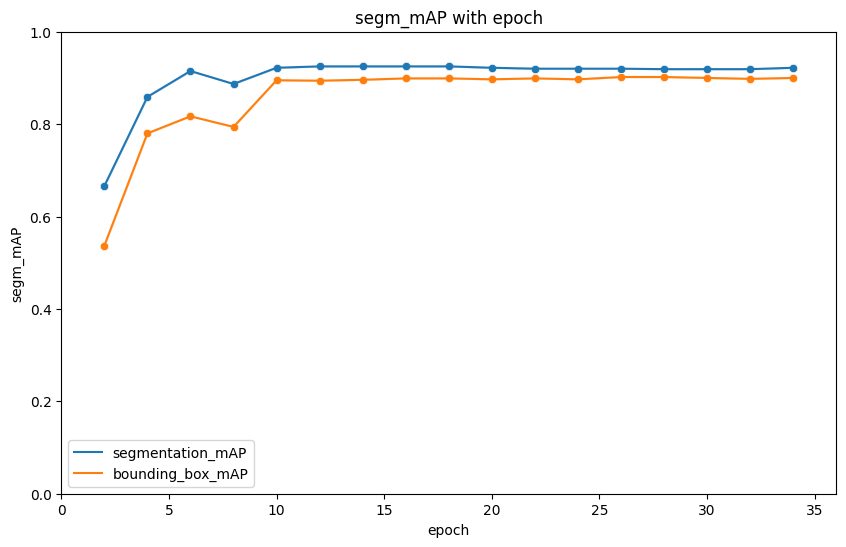

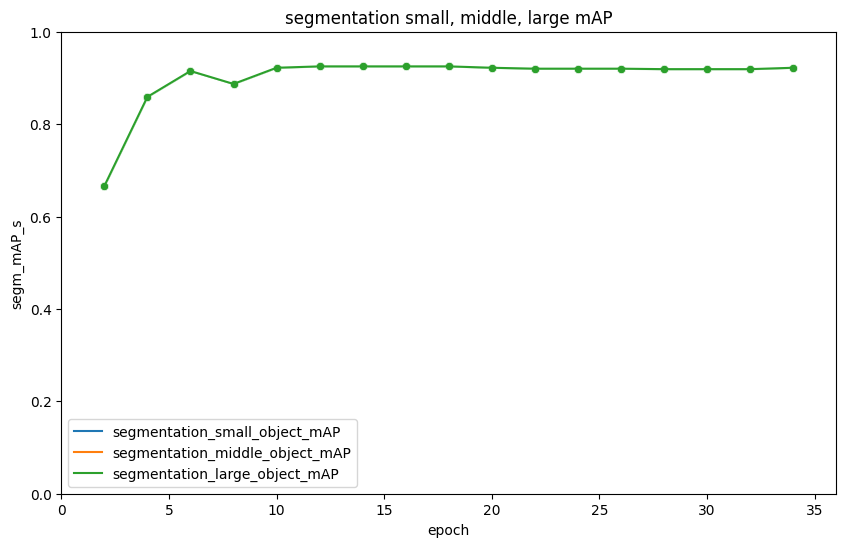

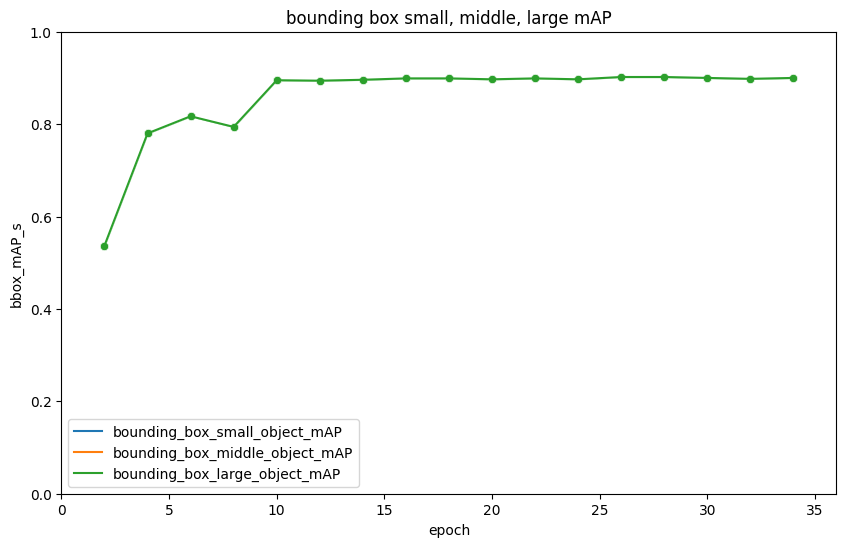

In [76]:
file_path = 'tutorial_exps/bloom_segment_model/None.log.json'
train, val = evaluate_mAP(file_path)
visualization(val, ymin=0, ymax=1.0, xmin=0, xmax=36)

### 빌렛크랙모델 mAP 평가

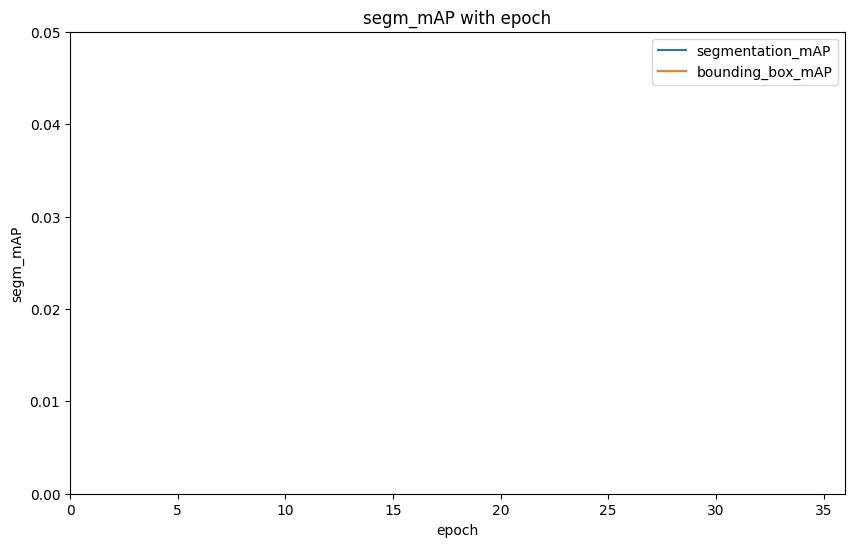

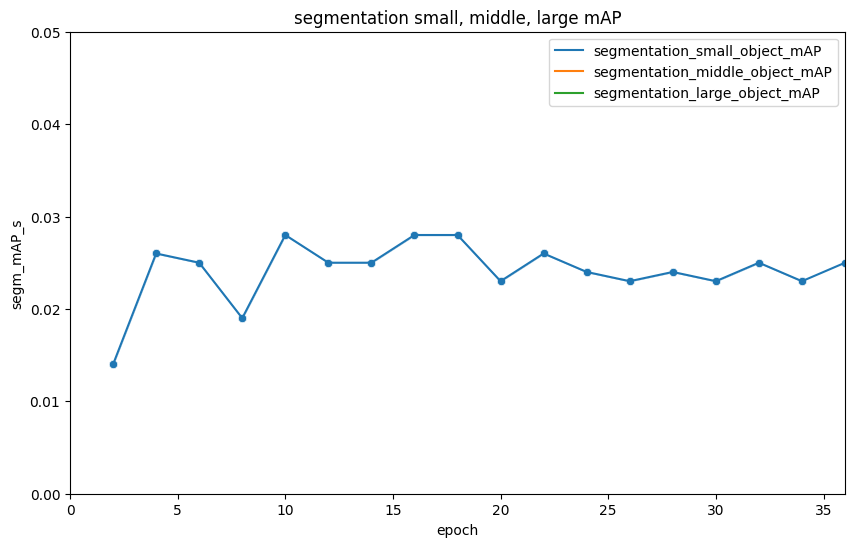

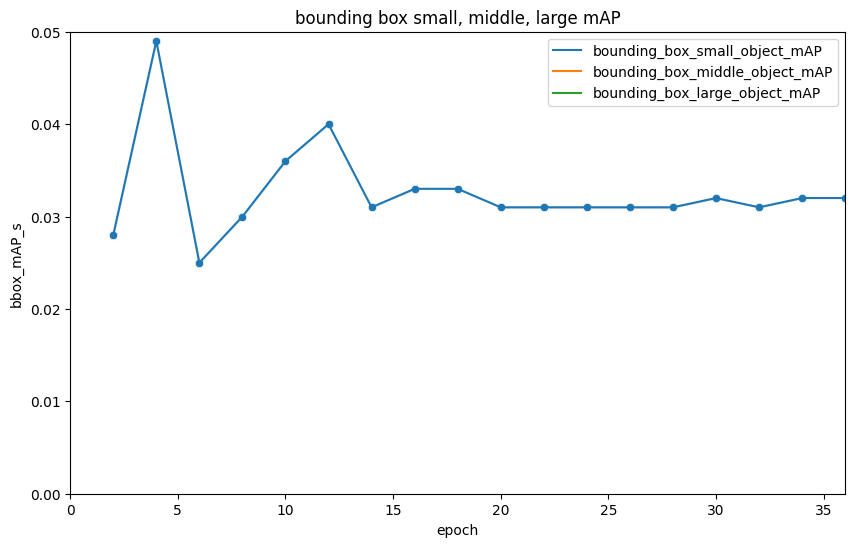

In [151]:
file_path = 'tutorial_exps/bloom_segment_model/빌렛단면크랙검출모델/None.log.json'
train, val = evaluate_mAP(file_path)
visualization(val, ymin=0, ymax=0.05, xmin=0, xmax=36)

### 블룸단면모델 mAP 평가

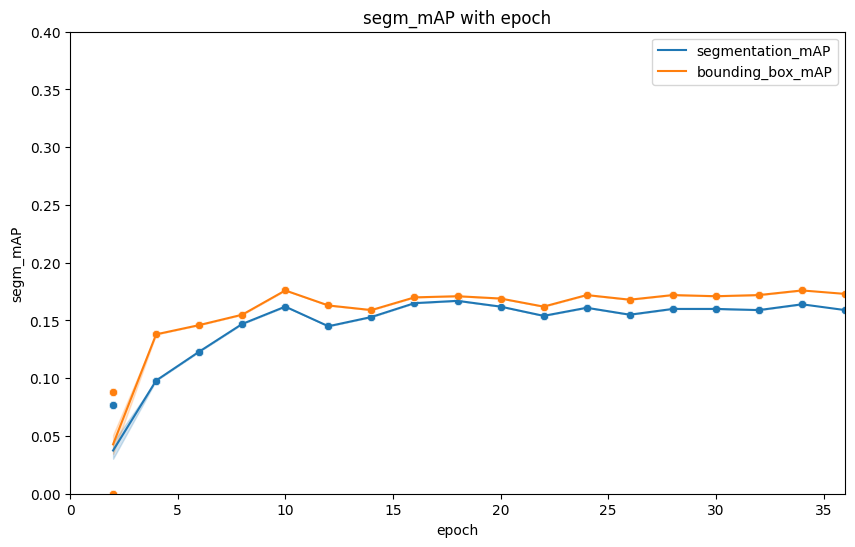

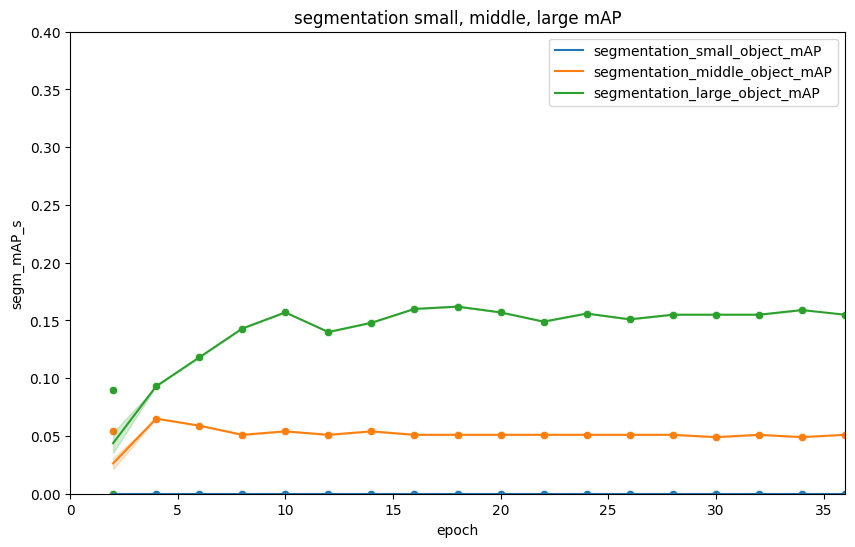

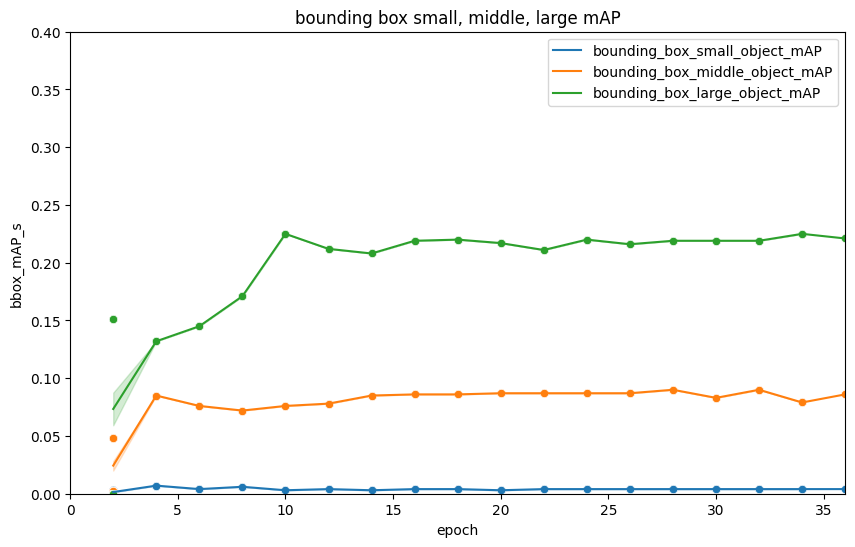

In [38]:
file_path = 'tutorial_exps/bloom_segment_model/블룸단면2차/None.log.json'
train, val = evaluate_mAP(file_path)
visualization(val, ymin=0, ymax=0.4, xmin=0, xmax=36)

### 블룸 L방향 mAP 계산

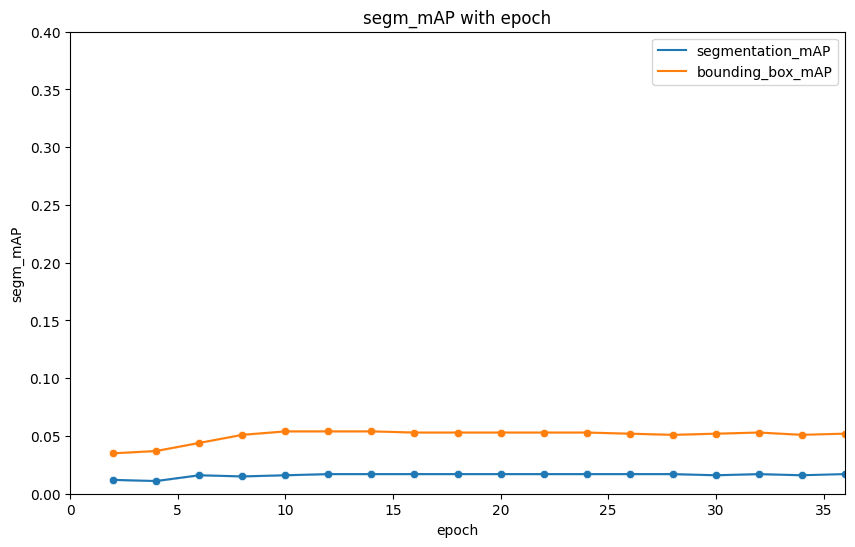

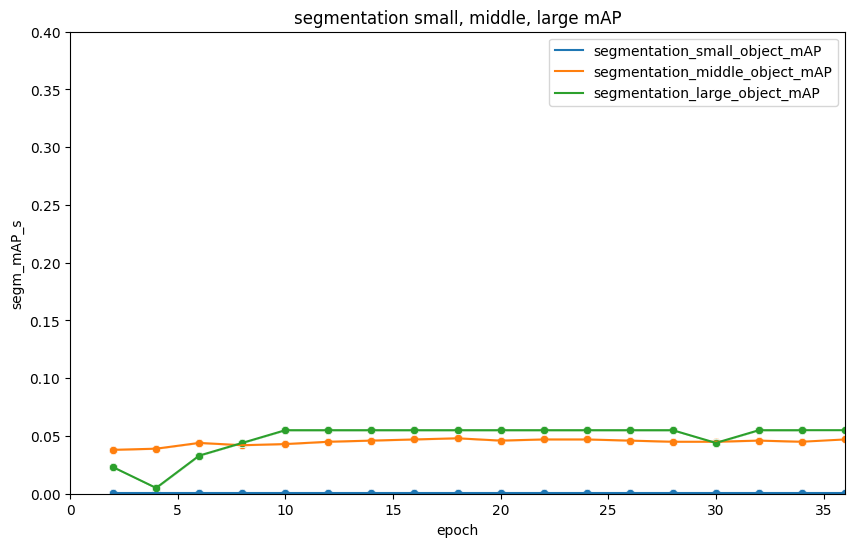

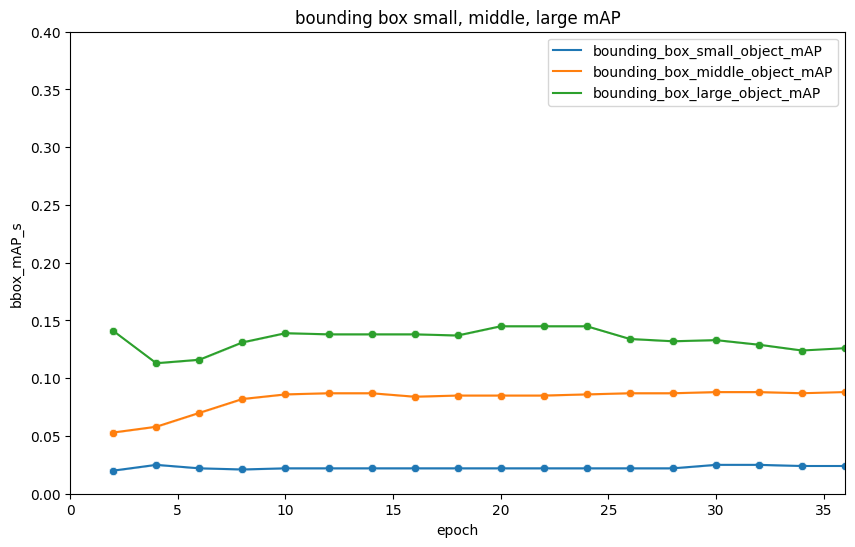

In [62]:
file_path = 'tutorial_exps/bloom_segment_model/None.log.json'
train, val = evaluate_mAP(file_path)
visualization(val, ymin=0, ymax=0.4, xmin=0, xmax=36)

### 블룸 표면 mAP 계산

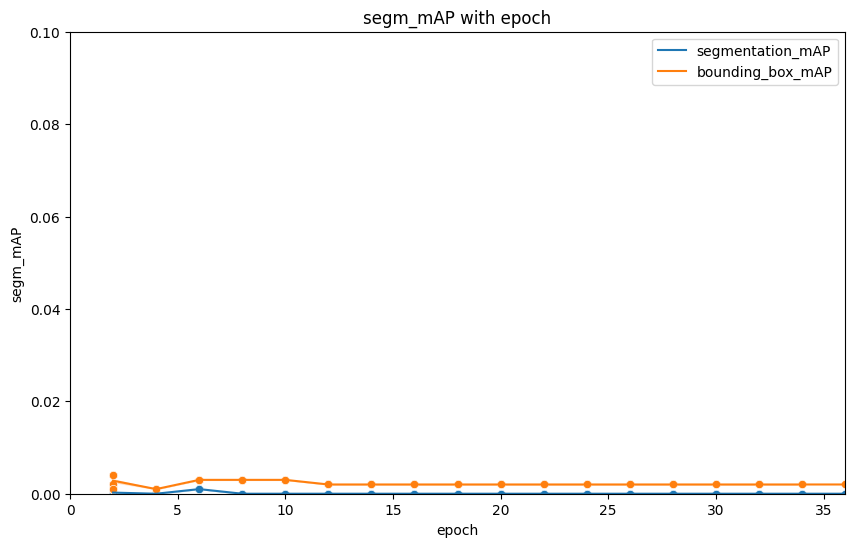

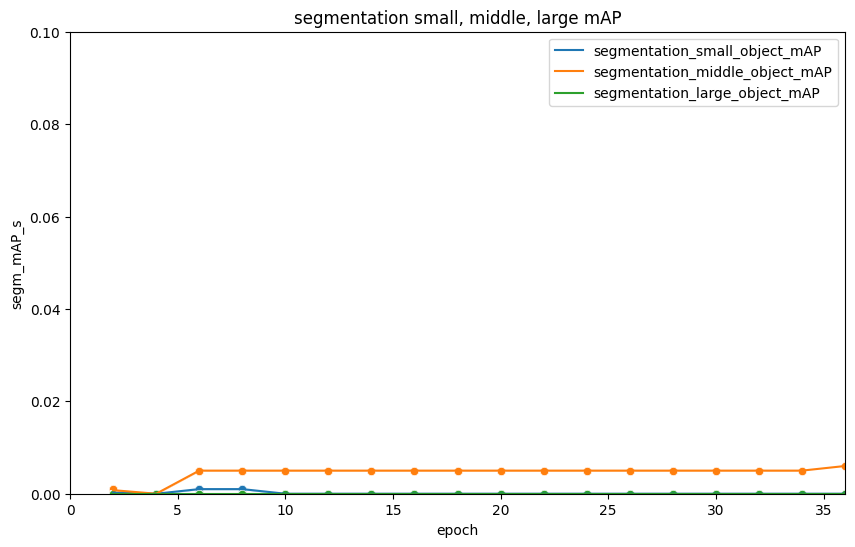

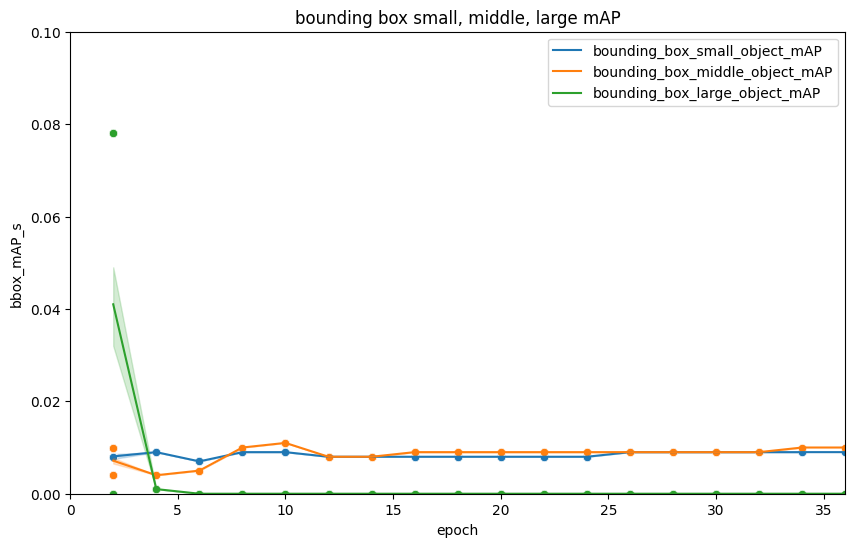

In [92]:
file_path = 'tutorial_exps/bloom_segment_model/블룸표면/None.log.json'
train, val = evaluate_mAP(file_path)
visualization(val, ymin=0, ymax=0.1, xmin=0, xmax=36)

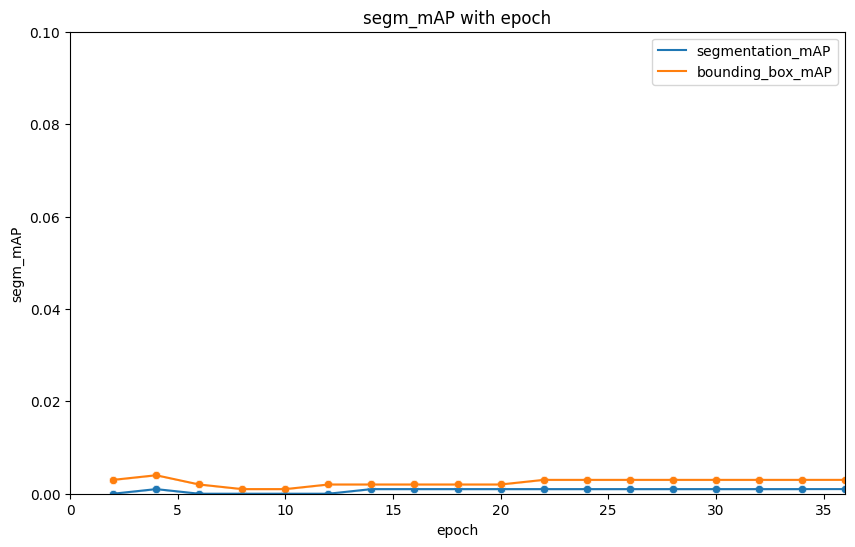

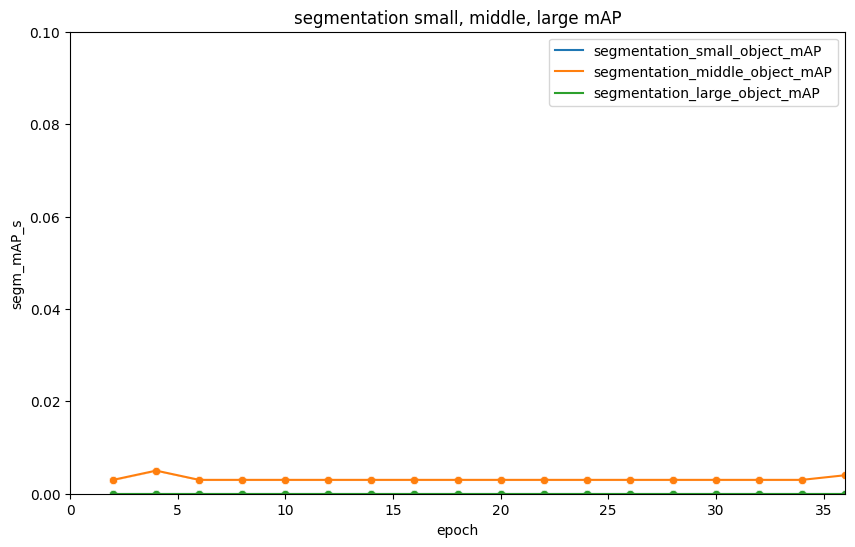

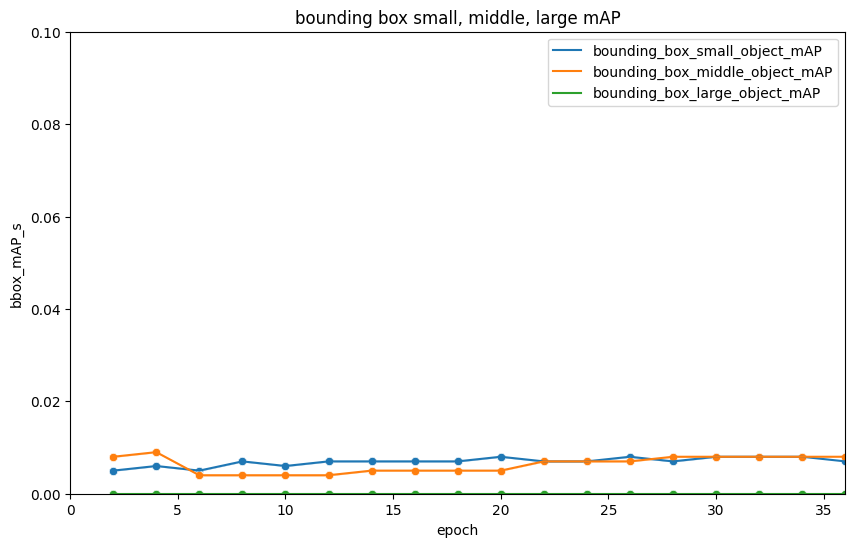

In [93]:
file_path = 'tutorial_exps/bloom_segment_model/블룸표면3차/None.log.json'
train, val = evaluate_mAP(file_path)
visualization(val, ymin=0, ymax=0.1, xmin=0, xmax=36)

### 블룸표면 epoch=5000

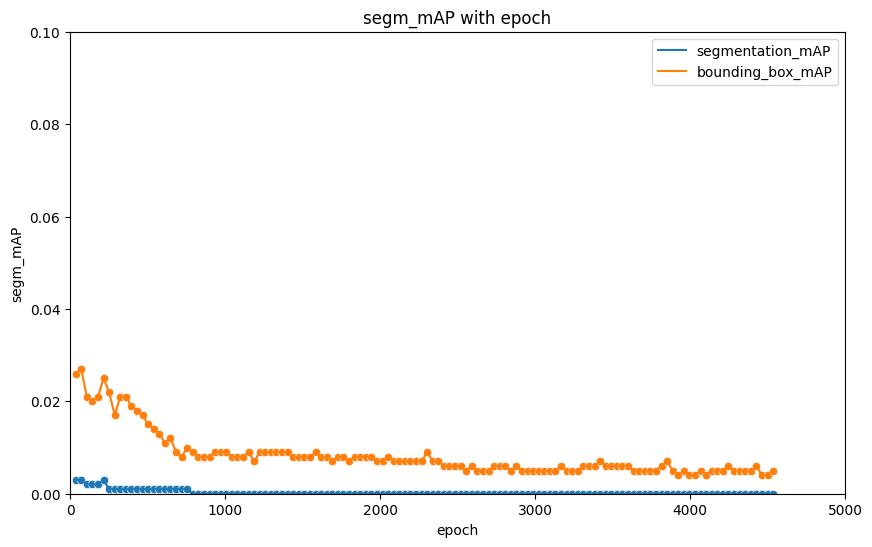

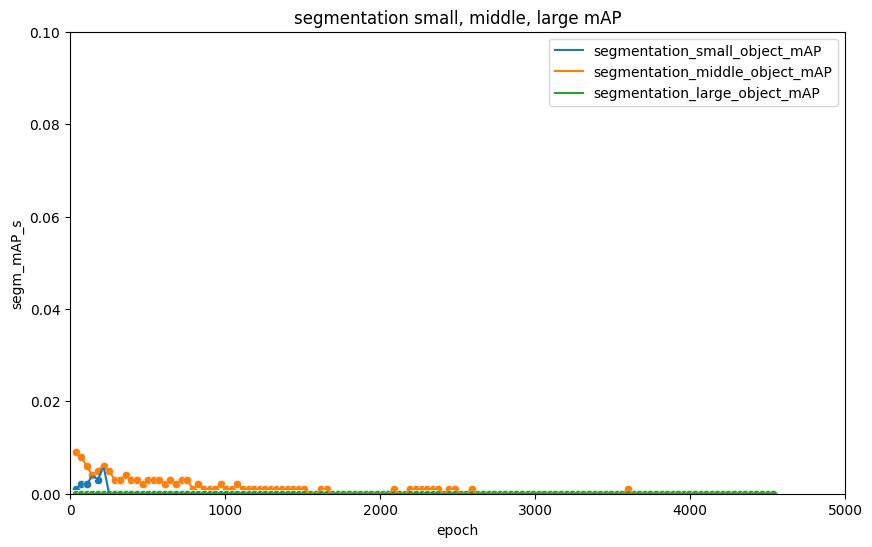

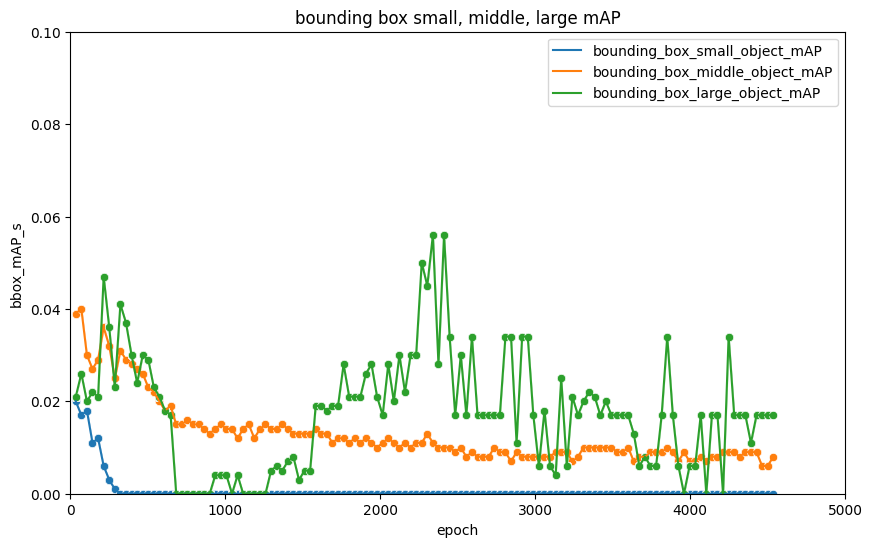

In [149]:
file_path = 'tutorial_exps/bloom_segment_model/None.log.json'
train, val = evaluate_mAP(file_path)
visualization(val, ymin=0, ymax=0.1, xmin=0, xmax=5000)

### Inference 수행
- show_result_pyplot()을 사용하지 않고, inference 이미지 Custom 시각화

In [129]:
# checkpoint_file = 'tutorial_exps/billet_segment_model/epoch_24.pth'
# checkpoint 저장된 model 파일을 이용하여 모델을 생성, 이때 Config는 위에서 update된 config 사용. 
checkpoint_file = 'tutorial_exps/bloom_segment_model/샘플분류/epoch_36.pth'
model_ckpt_1 = init_detector(cfg1, checkpoint_file, device='cuda:0')
checkpoint_file2 = 'tutorial_exps/bloom_segment_model/epoch_4428.pth'
# checkpoint_file2 = 'tutorial_exps/bloom_segment_model/epoch_10.pth'
model_ckpt_2 = init_detector(cfg2, checkpoint_file2, device='cuda:0')

labels_to_names_seq =  {0:'Crack', 
                        1:'billet', 
                        2:'Shrinkage', 
                        3:'Equiaxed_Area',
                        4:'Scratch',
                        5:'NotQuenching_Profile',
                        6:'Pinhole',
                        7:'Bleeding',
                        8:'Bloom',
                        9:'Bloom_TB_Surface',
                        10:'Bloom_Side_Surface',
                        11:'L_direction'}
COLORS = list(
    [[0, 0, 255],
    [0, 255, 0],
    [255, 0, 0],
    [0, 255, 255],
    [255, 255, 0],
    [255, 0, 255],
    [80, 70, 180],
    [250, 80, 190],
    [245, 145, 50],
    [70, 150, 250]] )

load checkpoint from local path: tutorial_exps/bloom_segment_model/샘플분류/epoch_36.pth
load checkpoint from local path: tutorial_exps/bloom_segment_model/epoch_4428.pth


In [130]:
def billet_cross_section_crack_classification(df, MACRO, p1=8.3, p2=20.8, p3=33.3, p4=50, p5=66.7, p6=79.2, p7=91.7):
    data = df.copy()

    #### 1) 특정샘플의 좌표를 정의한다
    bilet_left = data[(data['class'] == f'{MACRO}')]['left'].tolist()[0]
    bilet_top = data[(data['class'] ==f'{MACRO}')]['top'].tolist()[0]
    bilet_right = data[(data['class'] ==f'{MACRO}')]['right'].tolist()[0]
    bilet_bottom = data[(data['class'] ==f'{MACRO}')]['bottom'].tolist()[0]
    
    #### 2) 샘플좌표 대비 Object 가로세로 비율을 정의한다
    data['left_ratio'] = abs(data['left'] - bilet_left) / (bilet_right - bilet_left) * 100
    data['right_ratio'] = abs(data['right'] - bilet_left) / (bilet_right - bilet_left) * 100
    data['top_ratio'] = abs(data['top'] - bilet_top) / (bilet_bottom - bilet_top) * 100
    data['bottom_ratio'] = abs(data['bottom'] - bilet_top) / (bilet_bottom - bilet_top) * 100
    
    
    data['centerX_ratio'] = (data['left_ratio'] + data['right_ratio']) / 2
    data['centerY_ratio'] = (data['top_ratio'] + data['bottom_ratio']) / 2
    
    #### 3) Object 가로세로 비율을 기준으로 영역번호를 부여한다
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  <= p1), 'Position_number'] = 1
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 7
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p3), 'Position_number'] = 7
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p3) & (data['centerY_ratio']  <= p4), 'Position_number'] = 21
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p5), 'Position_number'] = 29
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p5) & (data['centerY_ratio']  <= p6), 'Position_number'] = 37
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 37
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 51
    
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  <= p1), 'Position_number'] = 2
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 8
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p3), 'Position_number'] = 15
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p3) & (data['centerY_ratio']  <= p4), 'Position_number'] = 22
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p5), 'Position_number'] = 30
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p5) & (data['centerY_ratio']  <= p6), 'Position_number'] = 38
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 45
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 52

    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  <= p1), 'Position_number'] = 2
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 9
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p3), 'Position_number'] = 16
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p3) & (data['centerY_ratio']  <= p4), 'Position_number'] = 23
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p5), 'Position_number'] = 31
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p5) & (data['centerY_ratio']  <= p6), 'Position_number'] = 39
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 46
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 52

    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  <= p1), 'Position_number'] = 3
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 10
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p3), 'Position_number'] = 17
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p3) & (data['centerY_ratio']  <= p4), 'Position_number'] = 24
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p5), 'Position_number'] = 32
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p5) & (data['centerY_ratio']  <= p6), 'Position_number'] = 40
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 47
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 53

    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  <= p1), 'Position_number'] = 4
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 11
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p3), 'Position_number'] = 18
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p3) & (data['centerY_ratio']  <= p4), 'Position_number'] = 25
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p5), 'Position_number'] = 33
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p5) & (data['centerY_ratio']  <= p6), 'Position_number'] = 41
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 48
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 54

    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  <= p1), 'Position_number'] = 5
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 12
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p3), 'Position_number'] = 19
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p3) & (data['centerY_ratio']  <= p4), 'Position_number'] = 26
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p5), 'Position_number'] = 34
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p5) & (data['centerY_ratio']  <= p6), 'Position_number'] = 42
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 49
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 55
    
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  <= p1), 'Position_number'] = 5
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 13
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p3), 'Position_number'] = 20
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p3) & (data['centerY_ratio']  <= p4), 'Position_number'] = 27
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p5), 'Position_number'] = 35
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p5) & (data['centerY_ratio']  <= p6), 'Position_number'] = 43
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 50
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 55
    
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  <= p1), 'Position_number'] = 6
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 14
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p3), 'Position_number'] = 14
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p3) & (data['centerY_ratio']  <= p4), 'Position_number'] = 28
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p5), 'Position_number'] = 36
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p5) & (data['centerY_ratio']  <= p6), 'Position_number'] = 44
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 44
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 56
    
    # 샘플은 (width_ratio, height_ratio) = (0,0)으로 0으로 무시한다
    data.loc[(data['centerX_ratio'] < 1) & (data['centerY_ratio']  < 1), 'Position_number'] = 0
    
    #### 4) 위치column 생성하고 영역번호 기준으로 위치과 결함을 분류하는 rule-base를 정의한다
    ############### 위치 정의 ###############
    conditions = [
        (data['Position_number'].isin([1, 8, 16, 2, 9])),  
        (data['Position_number'].isin([5, 6, 12, 13, 19])), 
        (data['Position_number'].isin([45, 46, 39, 52, 51])), 
        (data['Position_number'].isin([42, 49, 50, 55, 56])), 
        (data['Position_number'].isin([7, 15])), 
        (data['Position_number'].isin([38, 37])), 
        (data['Position_number'].isin([20, 14])), 
        (data['Position_number'].isin([44, 43])),
        
        (data['Position_number'].isin([3,4,10,11,17,18,24,25])),
        (data['Position_number'].isin([32,33,40,41,47,48,53,54])),
        (data['Position_number'].isin([21,22,23,29,30,31])),
        (data['Position_number'].isin([26,27,28,34,35,36])),
    ]
    choices = ['top_left', 'top_right', 'bottom_left', 'bottom_right', 'left_top', 'left_bottom', 'right_top', 'right_bottom', 'top', 'bottom', 'left', 'right']
    
    ############### 결함 정의 ###############
    # (1) 대각크랙
    diagonal = [8,16,13,19,45,39,50,42]
    # (2) 힌지크랙
    hinge = [2,5,52,55,7,37,14,44]
    # (3) 미드웨이크랙1
    midway1 = [3,4,53,54,21,29,28,36]
    # (4) 표면직하크랙
    subsurface_crack = [1,6,51,56]
    # (5) 미드웨이크랙2
    midway2 = [9,10,17,11,12,18,40,46,47,41,18,49,15,22,23,30,31,38,20,26,27,34,35,43]
    # (6) 중심부 SR크랙
    center_SR = [24,25,32,33]
    # (7) 샘플과 등축정은 제외한다
    sample = [0]
    # dictionary로 저장
    crack_dict = {
        'diagonal': diagonal,
        'hinge': hinge,
        'midway1': midway1,
        'subsurface_crack': subsurface_crack,
        'midway2': midway2,
        'center_SR': center_SR,
        'sample': sample
    }

    # loop을 사용하여 class_kind, Position 열 값을 설정
    for key, value in crack_dict.items():
        data.loc[data['Position_number'].isin(value), 'Position'] = key
        data.loc[data['Position_number'].isin(value), 'class_kind'] = key
        
    # Equiaxed_Area의 class도 'Sample'로 변경
    data.loc[data['class'] == 'Equiaxed_Area', ['class_kind', 'Position']] = 'sample'
    data['Position'] = np.select(conditions, choices)
    data.loc[
        (data['Position_number'] == 0), 'class_kind'] = 'Sample'
    data.loc[
        (data['Position_number'] == 0), 'Position'] = 'Sample'
    data.loc[
        (data['class'] == 'Equiaxed_Area'), 'class_kind'] = 'Sample'
    data.loc[
        (data['class'] == 'Equiaxed_Area'), 'Position'] = 'Sample'
    data.loc[
        (data['class'] == 'Crack') & (data['class_kind'] == 'diagonal') & (data['bbox_angle'] <= 40) | (data['class'] == 'Crack') & (data['class_kind'] == 'diagonal') & (data['bbox_angle'] >= 60), 'class_kind'] = 'hinge'
    
    
    #### 5) DataFrame으로 추가한다
    if (data.columns[-1:].to_list()[0] == 'class_kind') | (data.columns[-1:].to_list()[0] == 'Position'):        
        col1 = data.columns[:2].to_list()
        col2 = data.columns[-3:].to_list()
        col3 = data.columns[2:-3].to_list()
        new_col = col1 + col2 + col3
        data = data[new_col]
    else:
        pass
    
    return data

In [131]:
def bloom_cross_section_crack_classification(df, MACRO, p_width, p_height):
    data = df.copy()

    p1=p_width[0] 
    p2=p_width[1] 
    p3=p_width[2] # p8
    p4=p_width[3] 
    p5=p_width[4] # p9
    p6=p_width[5] 
    p7=p_width[6] 
    p8=p_height[2]
    p9=p_height[4]
    
    
    #### 1) 특정샘플의 좌표를 정의한다
    bilet_left = data[(data['class'] == f'{MACRO}')]['left'].tolist()[0]
    bilet_top = data[(data['class'] ==f'{MACRO}')]['top'].tolist()[0]
    bilet_right = data[(data['class'] ==f'{MACRO}')]['right'].tolist()[0]
    bilet_bottom = data[(data['class'] ==f'{MACRO}')]['bottom'].tolist()[0]
    
    #### 2) 샘플좌표 대비 Object 가로세로 비율을 정의한다
    data['left_ratio'] = abs(data['left'] - bilet_left) / (bilet_right - bilet_left) * 100
    data['right_ratio'] = abs(data['right'] - bilet_left) / (bilet_right - bilet_left) * 100
    data['top_ratio'] = abs(data['top'] - bilet_top) / (bilet_bottom - bilet_top) * 100
    data['bottom_ratio'] = abs(data['bottom'] - bilet_top) / (bilet_bottom - bilet_top) * 100
    
    
    data['centerX_ratio'] = (data['left_ratio'] + data['right_ratio']) / 2
    data['centerY_ratio'] = (data['top_ratio'] + data['bottom_ratio']) / 2
    
    #### 3) Object 가로세로 비율을 기준으로 영역번호를 부여한다
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  <= p1), 'Position_number'] = 1
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 7
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p8), 'Position_number'] = 7
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p3) & (data['centerY_ratio']  <= p4), 'Position_number'] = 21
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p9), 'Position_number'] = 29
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p5) & (data['centerY_ratio']  <= p6), 'Position_number'] = 37
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 37
    data.loc[(data['centerX_ratio'] <= p1) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 51
    
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  <= p1), 'Position_number'] = 2
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 8
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p8), 'Position_number'] = 15
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p8) & (data['centerY_ratio']  <= p4), 'Position_number'] = 22
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p9), 'Position_number'] = 30
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p9) & (data['centerY_ratio']  <= p6), 'Position_number'] = 38
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 45
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 52

    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  <= p1), 'Position_number'] = 2
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 9
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p8), 'Position_number'] = 16
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p8) & (data['centerY_ratio']  <= p4), 'Position_number'] = 23
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p9), 'Position_number'] = 31
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p9) & (data['centerY_ratio']  <= p6), 'Position_number'] = 39
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 46
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 52

    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  <= p1), 'Position_number'] = 3
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 10
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p8), 'Position_number'] = 17
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p8) & (data['centerY_ratio']  <= p4), 'Position_number'] = 24
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p9), 'Position_number'] = 32
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p9) & (data['centerY_ratio']  <= p6), 'Position_number'] = 40
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 47
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 53

    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  <= p1), 'Position_number'] = 4
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 11
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p8), 'Position_number'] = 18
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p8) & (data['centerY_ratio']  <= p4), 'Position_number'] = 25
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p9), 'Position_number'] = 33
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p9) & (data['centerY_ratio']  <= p6), 'Position_number'] = 41
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 48
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 54

    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  <= p1), 'Position_number'] = 5
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 12
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p8), 'Position_number'] = 19
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p8) & (data['centerY_ratio']  <= p4), 'Position_number'] = 26
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p9), 'Position_number'] = 34
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p9) & (data['centerY_ratio']  <= p6), 'Position_number'] = 42
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 49
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 55
    
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  <= p1), 'Position_number'] = 5
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 13
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p8), 'Position_number'] = 20
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p8) & (data['centerY_ratio']  <= p4), 'Position_number'] = 27
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p9), 'Position_number'] = 35
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p9) & (data['centerY_ratio']  <= p6), 'Position_number'] = 43
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 50
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 55
    
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  <= p1), 'Position_number'] = 6
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p1) & (data['centerY_ratio']  <= p2), 'Position_number'] = 14
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p2) & (data['centerY_ratio']  <= p8), 'Position_number'] = 14
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p8) & (data['centerY_ratio']  <= p4), 'Position_number'] = 28
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p4) & (data['centerY_ratio']  <= p9), 'Position_number'] = 36
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p9) & (data['centerY_ratio']  <= p6), 'Position_number'] = 44
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p6) & (data['centerY_ratio']  <= p7), 'Position_number'] = 44
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100) & (data['centerY_ratio']  > p7) & (data['centerY_ratio']  <= 100), 'Position_number'] = 56
    
    # 샘플은 (width_ratio, height_ratio) = (0,0)으로 0으로 무시한다
    data.loc[(data['centerX_ratio'] < 1) & (data['centerY_ratio']  < 1), 'Position_number'] = 0
    
    #### 4) 위치column 생성하고 영역번호 기준으로 위치과 결함을 분류하는 rule-base를 정의한다
    ############### 위치 정의 ###############
    conditions = [
        (data['Position_number'].isin([1, 8, 16, 2, 9])),  
        (data['Position_number'].isin([5, 6, 12, 13, 19])), 
        (data['Position_number'].isin([45, 46, 39, 52, 51])), 
        (data['Position_number'].isin([42, 49, 50, 55, 56])), 
        (data['Position_number'].isin([7, 15])), 
        (data['Position_number'].isin([38, 37])), 
        (data['Position_number'].isin([20, 14])), 
        (data['Position_number'].isin([44, 43])),
        
        (data['Position_number'].isin([3,4,10,11,17,18,24,25])),
        (data['Position_number'].isin([32,33,40,41,47,48,53,54])),
        (data['Position_number'].isin([21,22,23,29,30,31])),
        (data['Position_number'].isin([26,27,28,34,35,36])),
    ]
    choices = ['top_left', 'top_right', 'bottom_left', 'bottom_right', 'left_top', 'left_bottom', 'right_top', 'right_bottom', 'top', 'bottom', 'left', 'right']
    
    ############### 결함 정의 ###############
    # (1) 대각크랙
    diagonal = [8,16,13,19,45,39,50,42]
    # (2) 힌지크랙
    hinge = [2,5,52,55,7,37,14,44, 43, 49, 38, 15, 9, 12, 20]
    # (3) 미드웨이크랙1
    midway1 = [3,4,53,54,21,29,28,36]
    # (4) 표면직하크랙
    subsurface_crack = [1,6,51,56]
    # (5) 미드웨이크랙2
    midway2 = [10,17,11,18,40,46,47,41,18,22,23,30,31,26,27,34,35]
    # (6) 중심부 SR크랙
    center_SR = [24,25,32,33]
    # (7) 샘플과 등축정은 제외한다
    sample = [0]
    # dictionary로 저장
    crack_dict = {
        'diagonal': diagonal,
        'hinge': hinge,
        'midway1': midway1,
        'subsurface_crack': subsurface_crack,
        'midway2': midway2,
        'center_SR': center_SR,
        'sample': sample
    }

    # loop을 사용하여 class_kind, Position 열 값을 설정
    for key, value in crack_dict.items():
        data.loc[data['Position_number'].isin(value), 'Position'] = key
        data.loc[data['Position_number'].isin(value), 'class_kind'] = key
        
    # Equiaxed_Area의 class도 'Sample'로 변경
    data.loc[data['class'] == 'Equiaxed_Area', ['class_kind', 'Position']] = 'sample'
    data['Position'] = np.select(conditions, choices)
    data.loc[
        (data['Position_number'] == 0), 'class_kind'] = 'Sample'
    data.loc[
        (data['Position_number'] == 0), 'Position'] = 'Sample'
    data.loc[
        (data['class'] == 'Equiaxed_Area'), 'class_kind'] = 'Sample'
    data.loc[
        (data['class'] == 'Equiaxed_Area'), 'Position'] = 'Sample'
    data.loc[
        (data['class'] == 'Crack') & (data['class_kind'] == 'diagonal') & (data['bbox_angle'] <= 40) | (data['class'] == 'Crack') & (data['class_kind'] == 'diagonal') & (data['bbox_angle'] >= 70), 'class_kind'] = 'hinge'
    
    
    #### 5) DataFrame으로 추가한다
    if (data.columns[-1:].to_list()[0] == 'class_kind') | (data.columns[-1:].to_list()[0] == 'Position'):        
        col1 = data.columns[:2].to_list()
        col2 = data.columns[-3:].to_list()
        col3 = data.columns[2:-3].to_list()
        new_col = col1 + col2 + col3
        data = data[new_col]
    else:
        pass
    
    return data

In [132]:
def bloom_surface_crack_classification(df, MACRO, p1=8.3, p2=20.8, p3=33.3, p4=50, p5=66.7, p6=79.2, p7=91.7):
    data = df.copy()

    #### 1) 특정샘플의 좌표를 정의한다
    bilet_left = data[(data['class'] == f'{MACRO}')]['left'].tolist()[0]
    bilet_top = data[(data['class'] ==f'{MACRO}')]['top'].tolist()[0]
    bilet_right = data[(data['class'] ==f'{MACRO}')]['right'].tolist()[0]
    bilet_bottom = data[(data['class'] ==f'{MACRO}')]['bottom'].tolist()[0]
    
    #### 2) 샘플좌표 대비 Object 가로세로 비율을 정의한다
    data['left_ratio'] = abs(data['left'] - bilet_left) / (bilet_right - bilet_left) * 100
    data['right_ratio'] = abs(data['right'] - bilet_left) / (bilet_right - bilet_left) * 100
    data['top_ratio'] = abs(data['top'] - bilet_top) / (bilet_bottom - bilet_top) * 100
    data['bottom_ratio'] = abs(data['bottom'] - bilet_top) / (bilet_bottom - bilet_top) * 100
    
    
    data['centerX_ratio'] = (data['left_ratio'] + data['right_ratio']) / 2
    data['centerY_ratio'] = (data['top_ratio'] + data['bottom_ratio']) / 2
    
    #### 3) Object 가로 비율을 기준으로 영역번호를 부여한다
    data.loc[(data['centerX_ratio'] <= p1), 'Position_number'] = 1
    data.loc[(data['centerX_ratio'] > p1) & (data['centerX_ratio'] <= p2), 'Position_number'] = 2
    data.loc[(data['centerX_ratio'] > p2) & (data['centerX_ratio'] <= p3), 'Position_number'] = 3
    data.loc[(data['centerX_ratio'] > p3) & (data['centerX_ratio'] <= p4), 'Position_number'] = 4
    data.loc[(data['centerX_ratio'] > p4) & (data['centerX_ratio'] <= p5), 'Position_number'] = 5
    data.loc[(data['centerX_ratio'] > p5) & (data['centerX_ratio'] <= p6), 'Position_number'] = 6
    data.loc[(data['centerX_ratio'] > p6) & (data['centerX_ratio'] <= p7), 'Position_number'] = 7
    data.loc[(data['centerX_ratio'] > p7) & (data['centerX_ratio'] <= 100), 'Position_number'] = 8

    
    # 샘플은 (width_ratio, height_ratio) = (0,0)으로 0으로 무시한다
    data.loc[(data['centerX_ratio'] < 1) & (data['centerY_ratio']  < 1), 'Position_number'] = 0
    
    #### 4) 위치column 생성하고 영역번호 기준으로 위치과 결함을 분류하는 rule-base를 정의한다
    ############### 위치 정의 ###############
    
    if MACRO == 'Bloom_TB_Surface':
        conditions = [
            (data['Position_number'].isin([1])),  
            (data['Position_number'].isin([2])), 
            (data['Position_number'].isin([3])), 
            (data['Position_number'].isin([4,5])), 
            (data['Position_number'].isin([6])), 
            (data['Position_number'].isin([7])), 
            (data['Position_number'].isin([8]))]
        choices = ['left_corner', 'left_nearcorner', 'left_face', 'face', 'right_face', 'right_nearcorner', 'right_corner']
    elif MACRO == 'Bloom_Side_Surface':
        conditions = [
            (data['Position_number'].isin([1])),  
            (data['Position_number'].isin([2])), 
            (data['Position_number'].isin([3])), 
            (data['Position_number'].isin([4,5])), 
            (data['Position_number'].isin([6])), 
            (data['Position_number'].isin([7])), 
            (data['Position_number'].isin([8]))]
        choices = ['top_corner', 'top_nearcorner', 'top_face', 'face', 'bottom_face', 'bottom_nearcorner', 'bottom_corner']
    ############### 결함 정의 ###############
    # (1) 의미없는 값으로 에러나지 않기 위해 데이터프레임 열을 채우기 위한 코드
    sample = [0, 1, 2, 3, 4, 5, 6, 7, 8]
    # dictionary로 저장
    crack_dict = {
        'sample': sample
    }

    # loop을 사용하여 class_kind, Position 열 값을 설정
    for key, value in crack_dict.items():
        data.loc[data['Position_number'].isin(value), 'Position'] = key
        data.loc[data['Position_number'].isin(value), 'class_kind'] = key
        
    # Equiaxed_Area의 class도 'Sample'로 변경
    data.loc[data['class'] == 'Equiaxed_Area', ['class_kind', 'Position']] = 'sample'
    data['Position'] = np.select(conditions, choices)
    data.loc[
        (data['Position_number'] == 0), 'class_kind'] = 'Sample'
    data.loc[
        (data['Position_number'] == 0), 'Position'] = 'Sample'
    data.loc[
        (data['class'] == 'Equiaxed_Area'), 'class_kind'] = 'Sample'
    data.loc[
        (data['class'] == 'Equiaxed_Area'), 'Position'] = 'Sample'
    data.loc[
        (data['class'] == 'Crack') & (data['class_kind'] == 'diagonal') & (data['bbox_angle'] <= 40) | (data['class'] == 'Crack') & (data['class_kind'] == 'diagonal') & (data['bbox_angle'] >= 70), 'class_kind'] = 'hinge'
    
    
    #### 5) DataFrame으로 추가한다
    if (data.columns[-1:].to_list()[0] == 'class_kind') | (data.columns[-1:].to_list()[0] == 'Position'):        
        col1 = data.columns[:2].to_list()
        col2 = data.columns[-3:].to_list()
        col3 = data.columns[2:-3].to_list()
        new_col = col1 + col2 + col3
        data = data[new_col]
    else:
        pass
    # print(data)
    return data

In [133]:
def find_grain_parameters(contours, hierarchy, height, width):
    
    hierarchy = tuple(map(np.array, hierarchy))  # convert hierarchy list to tuple of numpy ndarrays

    if not contours:
        print('contours가 비어있습니다.')
        return 0, 0, 0, 0, [0, 0]

    ellipses = np.array([cv2.fitEllipse(cnt) for cnt in contours], dtype=object)

    if not ellipses.any():
        print('ellipses가 모두 0으로 측정')
        return 0, 0, 0, 0, [0, 0]

    if hierarchy is not None and len(hierarchy) == 3:
        hierarchy = [hierarchy[0]]

    major_axes = np.array([ellipse[1][1] for ellipse in ellipses])
    minor_axes = np.array([ellipse[1][0] for ellipse in ellipses])
    max_major_axis = np.max(major_axes)
    min_minor_axis = np.min(minor_axes)
    
    ## 등가직경 계산-------------------------
    valid_contours_indices = [contours.index(cnt) for cnt in contours if hierarchy[0][contours.index(cnt)][3] == -1]
    centroids = np.array([[cv2.moments(contours[idx])['m10'] / cv2.moments(contours[idx])['m00'], cv2.moments(contours[idx])['m01'] / cv2.moments(contours[idx])['m00']] for idx in valid_contours_indices])

    major_minor_product = np.array([[ma * MA] for ma, MA in zip(minor_axes, major_axes)])
    total_weight = np.sum(major_minor_product)
    weighted_centroids = np.multiply(centroids, major_minor_product)
    centroid = np.sum(weighted_centroids, axis=0) / total_weight
    
    ## 유효 장축길이 계산-------------------------
    min_valid_minor_axis = min(height, width)
    max_valid_major_axis = np.sqrt(height ** 2 + width ** 2) + min(height, width)
    
    valid_major_axes_indices = np.where((major_axes >= min_valid_minor_axis) & (major_axes <= max_valid_major_axis))
    valid_major_axes = major_axes[valid_major_axes_indices]
    valid_minor_axes = minor_axes[valid_major_axes_indices]

    valid_ellipses = ellipses[valid_major_axes_indices]
    
    # print(f'{min_valid_minor_axis} ~ {max_valid_major_axis}에 {valid_major_axes}가 있음')
    
    contour_area = cv2.contourArea(contours[0])
    equivalent_diameter = np.sqrt(4 * contour_area / np.pi)
    
    if not valid_ellipses.any():
        print('해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.')
        min_valid_minor_axis = min(height, width)
        max_valid_major_axis = max(height, width)
        
        
        largest_ellipse_index = np.argmax(major_axes)
        largest_ellipse = ellipses[largest_ellipse_index]
        
        major_axis = max(height, width)
        minor_axis = min(height, width)

        return major_axis, minor_axis, 0, 0, centroid, largest_ellipse

    largest_valid_ellipse_index = np.argmax(valid_major_axes)
    largest_valid_ellipse = valid_ellipses[largest_valid_ellipse_index]

    return valid_major_axes[0], valid_minor_axes[0], equivalent_diameter, contour_area, centroid, largest_valid_ellipse


In [134]:
# model과 원본 이미지 array, filtering할 기준 class confidence score를 인자로 가지는 inference 시각화용 함수 생성. 
# 이미 inference 시 mask boolean값이 들어오므로 mask_threshold 값을 필요하지 않음. 
def get_detected_img(model, img_array, color_list, Equiaxed_score_threshold=0.6, crack_score_threshold=0.3, draw_box=True, is_print=True, save=True, surface=None):
    # 인자로 들어온 image_array를 복사.
    draw_img = img_array.copy()
    bbox_color = (0, 255, 0)
    text_color = (0, 0, 0)
    object_img = img_array.copy()
    # model과 image array를 입력 인자로 inference detection 수행하고 결과를 results로 받음.
    results = inference_detector(model, img_array)
    bbox_results = results[0]
    seg_results = results[1]
    sample_box_point = []
    CLS = []    
    crack_class_result = {
        'crack_class': None,
        'bbox_angle': None,
        'mask_angle': None,
        'box': None,
        'img': None,
        'x': None,
        'y': None,
        'w': None,
        'h': None,
        'rect': None}
    
    df = pd.DataFrame()
    total_mask = np.zeros((draw_img.shape[0], draw_img.shape[1]))
    # results 리스트를 loop를 돌면서 개별 2차원 array들을 추출하고 이를 기반으로 이미지 시각화 
    # results 리스트의 위치 index가 매핑된 Class id. 여기서는 result_ind가 class id
    # 개별 2차원 array에 오브젝트별 좌표와 class confidence score 값을 가짐. 
    for result_ind, bbox_result in enumerate(bbox_results):
        # 개별 2차원 array의 row size가 0 이면 해당 Class id로 값이 없으므로 다음 loop로 진행.
        if len(bbox_result) == 0:
            # print(f'{result_ind}는 없음')
            continue
        
        mask_array_list = seg_results[result_ind]
        
        # 해당 클래스 별로 Detect된 여러개의 오브젝트 정보가 2차원 array에 담겨 있으며, 이 2차원 array를 row수만큼 iteration해서 개별 오브젝트의 좌표값 추출. 
        for i in range(len(bbox_result)):
            # print(bbox_result[i, 4])
            # print(crack_score_threshold, Equiaxed_score_threshold)
            # 좌상단, 우하단 좌표 추출.
            if (bbox_result[i, 4] > crack_score_threshold) & (result_ind == 0) | (bbox_result[i, 4] > Equiaxed_score_threshold) & (result_ind != 0):
                left = int(bbox_result[i, 0])
                top = int(bbox_result[i, 1])
                right = int(bbox_result[i, 2])
                bottom = int(bbox_result[i, 3])
                height = bottom - top
                width = right - left
                # area = height * width
                ### 1. 크랙길이
                crack_length = np.maximum(height, width)
                
                # masking 시각화 적용. class_mask_array는 image 크기 shape의  True/False값을 가지는 2차원 array
                class_mask_array = mask_array_list[i]
                
                # Bounding box의 각도를 구하기
                # print(class_mask_array, class_mask_array.shape)
                try:
                    contours, hierarchy = cv2.findContours(class_mask_array.astype('uint8'), cv2.RETR_TREE, cv2.CHAIN_APPROX_TC89_KCOS)
                    # print(contours)
                except:
                    print('컨투어 실패')
                    continue
                if not contours:
                    print('컨투어 없음')
                    continue
                if len(contours[0]) < 5:
                    print('컨투어 좌표 4개 이하')
                    continue

                ### 1. 크랙길이(장축), 등가직경, Area계산
                max_major_axis, min_minor_axis, equivalent_diameter, area, centroid, ellipses = find_grain_parameters(contours=[contours[0]], hierarchy=hierarchy, height=height, width=width)
                if max_major_axis == 0:
                    print('길이 계산실패')
                    continue
                
                area = class_mask_array[class_mask_array==True].sum()
                equvalant_size = np.sqrt(4 * area / np.pi)
                
                # if area == 0:
                #     area = class_mask_array[class_mask_array==True].sum()
                #     equvalant_size = np.sqrt(4 * area / np.pi)

                if area < 10: # Crack 면적이 0인 경우 bbox 면적 적용 
                    area = height * width
                    
                # A = class_mask_array[class_mask_array==True].sum()
                # print('mask_Area :', A, '타원면적 : ', area), 
                
                crack_length = max(height, width)
                rect = cv2.minAreaRect(contours[0])
                box = cv2.boxPoints(rect).astype(int)

                
                # 원본 image array에서 mask가 True인 영역만 별도 추출.
                masked_roi = draw_img[class_mask_array]
                Area_mask = np.maximum(class_mask_array, total_mask)
                
                color_index = result_ind % len(color_list)
                color = color_list[color_index]
                if (result_ind != 1) & (result_ind != 8) | (result_ind != 9) | (result_ind != 10) | (result_ind != 11):
                    draw_img[class_mask_array] = ([0.3*color[0], 0.3*color[1], 0.3*color[2]] + 0.6 * masked_roi).astype(np.uint8)
                    total_mask = np.maximum(class_mask_array, total_mask)
                    object_mask = np.where(total_mask > 0, 255, total_mask)
                    
                    cropped_mask = object_mask[top:bottom, left:right].astype(np.uint8)
                    cropped_image = object_img[top:bottom, left:right].astype(np.uint8)
                    
                    
                # if surface == True & (result_ind == 0): #블룸표면마크로인 경우 형상분류 필요함
                if (result_ind == 0): #블룸표면마크로인 경우 형상분류 필요함
                    # print('블룸표면마크로인 경우 형상분류 필요함', cropped_mask.shape, np.unique(cropped_mask))
                    # print(cropped_mask)
                    crack_class_result =  classify_crack(img = cropped_mask)
                    # 표면 입계, 횡, 종 구분
                    crack_class = crack_class_result['crack_class']
                    # masking 각도를 구하기
                    # bbox_angle = crack_class_result['bbox_angle]
                    # mask_angle = crack_class_result['mask_angle]
                    
                if draw_box:                    
                    if result_ind == 0:
                        if crack_score_threshold < 0.13: # crack_score_threshold=0.08 정도로 낮은 경우 
                            crack_score_threshold = 0.13 # crack_score_threshold=0.13 변경 
                        if bbox_result[i, 4] > crack_score_threshold: 
                            if surface == True:
                                caption = '{}:{}: {:.4f}, ({}, {}), ({}, {}), w:{},h:{}, A:{}, L:{}'.format(labels_to_names_seq[result_ind], crack_class, bbox_result[i, 4], left, top, right, bottom, width, height, area, max_major_axis)
                            caption = '{}: {:.4f}, ({}, {}), ({}, {}), w:{},h:{}, A:{}, L:{}'.format(labels_to_names_seq[result_ind], bbox_result[i, 4], left, top, right, bottom, width, height, area, max_major_axis)
                            # cv2.rectangle(draw_img, (left, top), (right, bottom), color=bbox_color, thickness=4)
                            # cv2.ellipse(draw_img, ellipses, color=bbox_color, thickness=4)
                            cv2.drawContours(draw_img, [box], 0, color=bbox_color, thickness=4)
                            cv2.putText(draw_img, caption, (left - 500, top - 7), cv2.FONT_HERSHEY_SIMPLEX, 1.5, text_color, 6)
                        else:
                            pass
                    elif (result_ind == 1) | (result_ind == 8) | (result_ind == 9) | (result_ind == 10) | (result_ind == 11):
                        caption = '{}: {:.4f}, ({}, {}), ({}, {}), w:{},h:{}, A:{}'.format(labels_to_names_seq[result_ind], bbox_result[i, 4], left, top, right, bottom, width, height, area)
                        # cv2.rectangle(draw_img, (left, top), (right, bottom), color=bbox_color, thickness=6)
                        cv2.drawContours(draw_img, [box], 0, color=bbox_color, thickness=6)
                        cv2.putText(draw_img, caption, (left - 500, top - 7), cv2.FONT_HERSHEY_SIMPLEX, 1.5, text_color, 6)
                        # 샘플각도에 맞게 그림을 그릴수있는 box 좌표 수집
                        sample_box_point = box.copy()
                        # print(sample_box_point)
                        
                    elif result_ind == 2:
                        caption = '{}: {:.4f}, ({}, {}), ({}, {}), size:{}'.format(labels_to_names_seq[result_ind], bbox_result[i, 4], left, top, right, bottom, equvalant_size)   
                        # cv2.rectangle(draw_img, (left, top), (right, bottom), color=bbox_color, thickness=6)
                        cv2.drawContours(draw_img, [box], 0, color=bbox_color, thickness=6)
                        cv2.putText(draw_img, caption, (left - 500, top - 7), cv2.FONT_HERSHEY_SIMPLEX, 1.5, text_color, 6)
                    elif result_ind == 3:
                        caption = '{}: {:.4f}, ({}, {}), ({}, {}), A:{}'.format(labels_to_names_seq[result_ind], bbox_result[i, 4], left, top, right, bottom, area)    
                        # cv2.rectangle(draw_img, (left, top), (right, bottom), color=bbox_color, thickness=6)
                        cv2.drawContours(draw_img, [box], 0, color=bbox_color, thickness=6)
                        cv2.putText(draw_img, caption, (left + 500, top - 7), cv2.FONT_HERSHEY_SIMPLEX, 1.5, text_color, 6)  
                    elif (result_ind == 4) |(result_ind == 5) | (result_ind == 6) | (result_ind == 7):
                        caption = '{}: {:.4f}, ({}, {}), ({}, {}), w:{},h:{}, A:{}'.format(labels_to_names_seq[result_ind], bbox_result[i, 4], left, top, right, bottom, width, height, area)
                        # cv2.rectangle(draw_img, (left, top), (right, bottom), color=bbox_color, thickness=6)
                        cv2.drawContours(draw_img, [box], 0, color=bbox_color, thickness=6)
                        cv2.putText(draw_img, caption, (left - 500, top - 7), cv2.FONT_HERSHEY_SIMPLEX, 1.5, text_color, 6)


                #color를 임의 지정
                # color_index = np.random.randint(0, len(COLORS) - 1)
                # color를 class별로 지정

                # print(color_index, color)
                # apply_mask()함수를 적용시 수행 시간이 상대적으로 오래 걸림. 
                #draw_img = apply_mask(draw_img, class_mask_array, color, alpha=0.4)
                # 원본 이미지의 masking 될 영역에 mask를 특정 투명 컬러로 적용
                # if (result_ind != 1) & (result_ind != 3):

                if save:
                    cv2.imwrite('tutorial_exps/bloom_segment_model/객체모음집/CROP_MASK/{}_{}.png'.format(labels_to_names_seq[result_ind], i), cropped_mask)
                    cv2.imwrite('tutorial_exps/bloom_segment_model/객체모음집/CROP_CRACK/{}_{}.png'.format(labels_to_names_seq[result_ind], i), cropped_image)
                    
                if is_print:
                    print(caption)
    
                if result_ind == 0:
                    if crack_score_threshold < 0.13: # crack_score_threshold=0.08 정도로 낮은 경우 
                        crack_score_threshold = 0.13 # crack_score_threshold=0.13 변경 
                    if bbox_result[i, 4] > crack_score_threshold: 
                        data = pd.DataFrame({
                            'class' : [labels_to_names_seq[result_ind]],
                            'surface_crack' : [crack_class_result['crack_class']],
                            'IoU_Confidence_Score' : [bbox_result[i, 4]],
                            'left' : [left],
                            'top' : [top], 
                            'right' : [right], 
                            'bottom' : [bottom], 
                            'width' : [width], 
                            'height' : [height], 
                            'area' : [area], 
                            'bbox_angle' : [crack_class_result['bbox_angle']],
                            'mask_angle' : [crack_class_result['mask_angle']],
                            'equvalant_size' : [equvalant_size], 
                            'crack_length' : [max_major_axis]})
                else:
                    data = pd.DataFrame({
                        'class' : [labels_to_names_seq[result_ind]],
                        'surface_crack' : [crack_class_result['crack_class']],
                        'IoU_Confidence_Score' : [bbox_result[i, 4]],
                        'left' : [left],
                        'top' : [top], 
                        'right' : [right], 
                        'bottom' : [bottom], 
                        'width' : [width], 
                        'height' : [height], 
                        'area' : [area], 
                        'bbox_angle' : [crack_class_result['bbox_angle']],
                        'mask_angle' : [crack_class_result['mask_angle']],
                        'equvalant_size' : [equvalant_size], 
                        'crack_length' : [max_major_axis]})
                
                # 샘플이 무슨샘플인지 알려주는 CLASS 수집
                if (result_ind == 1) | (result_ind == 8) | (result_ind == 9) | (result_ind == 10) | (result_ind == 11):
                    CLS.append(result_ind)
    
                df = pd.concat([df, data], axis=0, ignore_index=True)
            

    return draw_img, total_mask, df, CLS, sample_box_point

In [146]:
def double_detected_img(model_ckpt_1, model_ckpt_2, p_list, img_arr, color_list=COLORS, Equiaxed_score_threshold=0.6, crack_score_threshold=0.3, draw_box=True, is_print=True, save=True):
    draw_img = img_arr.copy()
    # 결함 분류 기준 설정
    p1 = p_list[0]
    p2 = p_list[1]
    p3 = p_list[2]
    p4 = p_list[3]
    p5 = p_list[4]
    p6 = p_list[5]
    p7 = p_list[6]
    print(p_list)

    # 검출 판정 2번 하기 : model_ckpt_1(샘플), model_ckpt_2(크랙, 수축공, 등축정)
    print('검출 판정 1번째')
    first_img, total_mask, first_df, first_CLS, first_sample_box_point = get_detected_img(model_ckpt_1, draw_img, color_list=color_list, Equiaxed_score_threshold=Equiaxed_score_threshold, crack_score_threshold=Equiaxed_score_threshold, draw_box=draw_box, is_print=is_print, save=save, surface=None)
    MACRO = labels_to_names_seq[first_CLS[0]]
    print(first_CLS)
    print(first_CLS[0])

    print(f'{MACRO}로 샘플분류완료. 샘플분류에 맞게 2차판정진행')
    if (MACRO == 'Bloom_TB_Surface') | (MACRO == 'Bloom_Side_Surface'): # 블룸표면
        # 샘플에 맞게 모델변경
        # checkpoint_file2 = 'tutorial_exps/bloom_segment_model/블룸표면/epoch_36.pth'
        checkpoint_file2 = 'tutorial_exps/bloom_segment_model/epoch_72.pth'
        model_ckpt_2 = init_detector(cfg2, checkpoint_file2, device='cuda:0')
        
        surface = True
        second_img, total_mask, second_df, second_CLS, second_sample_box_point = get_detected_img(model_ckpt_2, draw_img, color_list=color_list, Equiaxed_score_threshold=Equiaxed_score_threshold, crack_score_threshold=crack_score_threshold, draw_box=draw_box, is_print=is_print, save=save, surface=surface)
    
        # 1, 2 판정 데이터 취합하기
        df = pd.concat([second_df, first_df[(first_df['class'] == f'{MACRO}')]], axis=0, ignore_index=True)

        ### 6. 표면 : 좌우 코너으로부터 거리 : Distance_from_side
        x = np.minimum(abs(df['left'] - df[(df['class']==f'{MACRO}')]['left'].tolist()[0]), abs(df['right'] - df[(df['class']==f'{MACRO}')]['right'].tolist()[0])) 
        df['Distance_from_side'] = x + df['width']
        ### 9. 결함분류 및 위치번호 계산
        if (MACRO == 'Bloom_TB_Surface'):
            p_list =  [5.883, 20.8, 33.3, 50, 66.7, 79.2, 94.117] # Bloom_TB_Surface 기준 : 정코너 감안하여 30mm까지 정코너로 판정
            df = bloom_surface_crack_classification(df, MACRO=MACRO, p1=p_list[0], p2=p_list[1], p3=p_list[2], p4=p_list[3], p5=p_list[4], p6=p_list[5], p7=p_list[6])
        elif (MACRO == 'Bloom_Side_Surface'):  
            # 결함 분류 기준 설정
            p_list =  [2.82, 20.8, 33.3, 50, 66.7, 79.2, 97.18] # Bloom_Side_Surface 기준 : 정코너 절단 감안하여 11mm까지 정코너로 판정 
            df = bloom_surface_crack_classification(df, MACRO=MACRO, p1=p_list[0], p2=p_list[1], p3=p_list[2], p4=p_list[3], p5=p_list[4], p6=p_list[5], p7=p_list[6])
        # print(df)
        ### 크랙분류 데이터 추가
        df['class_kind']= df['surface_crack']
        # 필요없는 품질지표는 모두 None 처리
        df['Area_ratio%'] = None
        df['Equiaxed_Area_ratio%'] = None
        # df['Distance_from_surface'] = None
        df['L_shrinkage_size'] = None
        df['top_dendrite_length'] = None
        # df['centerX_ratio'] = None
        # df['centerY_ratio'] = None

    elif (MACRO == 'billet')| (MACRO == 'Bloom'): # 블룸 빌렛 단면
        if (MACRO == 'Bloom'):            
            # 샘플에 맞게 모델변경
            checkpoint_file2 = 'tutorial_exps/bloom_segment_model/블룸단면/epoch_36.pth'
            model_ckpt_2 = init_detector(cfg2, checkpoint_file2, device='cuda:0')
        if (MACRO == 'billet'):            
            # 샘플에 맞게 모델변경
            checkpoint_file2 = 'tutorial_exps/bloom_segment_model/빌렛단면/epoch_36.pth'
            model_ckpt_2 = init_detector(cfg2, checkpoint_file2, device='cuda:0')
        
        second_img, total_mask, second_df, second_CLS, second_sample_box_point = get_detected_img(model_ckpt_2, draw_img, color_list=color_list, Equiaxed_score_threshold=Equiaxed_score_threshold, crack_score_threshold=crack_score_threshold, draw_box=draw_box, is_print=is_print, save=save, surface=None)
    
        # 1, 2 판정 데이터 취합하기
        df = pd.concat([second_df, first_df[(first_df['class'] == f'{MACRO}') | (first_df['class'] == 'Equiaxed_Area') | (first_df['class'] == 'NotQuenching_Profile')]], axis=0, ignore_index=True)
        
        ### 4. 등축정률 계산 : Equiaxed_Area_ratio%
        # print(df)
        billet_area = df[(df['class'] == f'{MACRO}')]['area'].to_list()[0]
        df['Area_ratio%'] = df['area'] / billet_area * 100
        df['Equiaxed_Area_ratio%'] = df[(df['class']=='Equiaxed_Area')]['Area_ratio%'].quantile(q=0.5, interpolation='linear')
        ### 5. 표면으로부터 거리 : Distance_from_surface
        #### : (top - billet_top, bottom - billet_bottom) y 최소값과 (left - billet_left, right - billet_right) x 최소값 둘 중 가장 최소값
        x = np.minimum(abs(df['left'] - df[(df['class']==f'{MACRO}')]['left'].tolist()[0]), abs(df['right'] - df[(df['class']==f'{MACRO}')]['right'].tolist()[0])) 
        y = np.minimum(abs(df['top'] - df[(df['class']==f'{MACRO}')]['top'].tolist()[0]), abs(df['bottom'] - df[(df['class']==f'{MACRO}')]['bottom'].tolist()[0])) 
        df['Distance_from_surface'] = np.minimum(x, y)
        ### 6. 표면 : 좌우 코너으로부터 거리 : Distance_from_side
        df['Distance_from_side'] = x + df['width']
        ### 7. L방향 : 수축공 크기 : L_shrinkage_size
        df['L_shrinkage_size'] = df[df['class']=='Shrinkage']['width'].quantile(q=0.7, interpolation='linear')
        ### 8. 상부 덴드라이트 길이
        df['top_dendrite_length'] = (df[(df['class'] == 'Equiaxed_Area')]['top'].max() - df['top']).apply(lambda x: x if x > 0 else 0)
        df['top_dendrite_length'] = df[(df['class']==f'{MACRO}')]['top_dendrite_length'].tolist()[0]
        ### 9. 결함분류 및 위치번호 계산
        if (MACRO == 'Bloom'):  
            # 결함 분류 기준 설정
            p_width =  [5.883, 20.8, 33.3, 50, 66.7, 79.2, 94.117] # Bloom 너비 기준 
            p_height =  [5.883, 20.8, 40, 50, 60, 79.2, 94.117] # Bloom 높이 기준         
            df = bloom_cross_section_crack_classification(df, MACRO, p_width=p_width, p_height=p_height)
        elif (MACRO == 'billet'):  
            # 결함 분류 기준 설정
            p_list =  [8.3, 20.8, 33.3, 50, 66.7, 79.2, 91.7] # Billet 기준
            df = billet_cross_section_crack_classification(df, MACRO=MACRO, p1=p_list[0], p2=p_list[1], p3=p_list[2], p4=p_list[3], p5=p_list[4], p6=p_list[5], p7=p_list[6])
        # 필요없는 품질지표는 모두 None 처리
        df['surface_crack'] = None

    
    elif (MACRO == 'L_direction'): # L방향
        # 샘플에 맞게 모델변경
        checkpoint_file2 = 'tutorial_exps/bloom_segment_model/블룸L방향/epoch_36.pth'
        model_ckpt_2 = init_detector(cfg2, checkpoint_file2, device='cuda:0')
        
        second_img, total_mask, second_df, second_CLS, second_sample_box_point = get_detected_img(model_ckpt_2, draw_img, color_list=color_list, Equiaxed_score_threshold=Equiaxed_score_threshold, crack_score_threshold=crack_score_threshold, draw_box=draw_box, is_print=is_print, save=save, surface=None)
        # 1, 2 판정 데이터 취합하기
        df = pd.concat([second_df, first_df[(first_df['class'] == f'{MACRO}') | (first_df['class'] == 'Equiaxed_Area')]], axis=0, ignore_index=True)
        ### 6. 표면 : 좌우 코너으로부터 거리 : Distance_from_side
        x = np.minimum(abs(df['left'] - df[(df['class']==f'{MACRO}')]['left'].tolist()[0]), abs(df['right'] - df[(df['class']==f'{MACRO}')]['right'].tolist()[0])) 
        df['Distance_from_side'] = x
        ### 7. L방향 : 수축공 크기 : L_shrinkage_size
        df['L_shrinkage_size'] = df[df['class']=='Shrinkage']['width'].quantile(q=0.7, interpolation='linear')
        ### 9. 결함분류 및 위치번호 계산
        df = bloom_cross_section_crack_classification(df, MACRO=MACRO, p1=p1, p2=p2, p3=p3, p4=p4, p5=p5)
        df.loc[df['class']=='Crack', 'class_kind'] = 'midway2'
        df.loc[df['class']=='Shrinkage', 'class_kind'] = 'center_SR'
        
        # 필요없는 품질지표는 모두 None 처리
        df['Area_ratio%'] = None
        df['Equiaxed_Area_ratio%'] = None
        df['Distance_from_surface'] = None
        df['surface_crack'] = None
        df['top_dendrite_length'] = None
        # df['centerX_ratio'] = None
        # df['centerY_ratio'] = None

    else: # 샘플분류판정 실패하면 종료
        pass
    
    # 데이터프레임 열 순서 고정
    df = df.reindex(columns=['class', 'surface_crack', 'Position_number', 'Position', 'class_kind',
       'IoU_Confidence_Score', 'left', 'top', 'right', 'bottom', 'width',
       'height', 'area', 'bbox_angle', 'mask_angle', 'equvalant_size',
       'crack_length', 'Area_ratio%', 'Equiaxed_Area_ratio%',
       'Distance_from_surface', 'Distance_from_side', 'L_shrinkage_size',
       'top_dendrite_length', 'left_ratio', 'right_ratio', 'top_ratio',
       'bottom_ratio', 'centerX_ratio', 'centerY_ratio'])
    
    if is_print:
        bbox_color = (0, 255, 0)
        text_color = (0, 0, 0)
        if 'NotQuenching_Profile' in first_df['class'].values:
            NotQuenching_IoU_Confidence_Score = first_df[(first_df['class'] == f'{MACRO}')].IoU_Confidence_Score.tolist()[0]
            NotQuenching_left = first_df[(first_df['class'] == 'NotQuenching_Profile')].left.tolist()[0]
            NotQuenching_top = first_df[(first_df['class'] == 'NotQuenching_Profile')].top.tolist()[0]
            NotQuenching_right = first_df[(first_df['class'] == 'NotQuenching_Profile')].right.tolist()[0]
            NotQuenching_bottom = first_df[(first_df['class'] == 'NotQuenching_Profile')].bottom.tolist()[0]
            NotQuenching_width = first_df[(first_df['class'] == 'NotQuenching_Profile')].width.tolist()[0]
            NotQuenching_height = first_df[(first_df['class'] == 'NotQuenching_Profile')].height.tolist()[0]
            NotQuenching_area = first_df[(first_df['class'] == f'NotQuenching_Profile')].area.tolist()[0]
            
            caption = '{}: {:.4f}, ({}, {}), ({}, {}), w:{},h:{}, A:{}'.format('NotQuenching_Profile', NotQuenching_IoU_Confidence_Score, NotQuenching_left, NotQuenching_top, NotQuenching_right, NotQuenching_bottom, NotQuenching_width, NotQuenching_height, NotQuenching_area)
            cv2.rectangle(second_img, (NotQuenching_left, NotQuenching_top), (NotQuenching_right, NotQuenching_bottom), color=bbox_color, thickness=6)
            cv2.putText(second_img, caption, (NotQuenching_left + 1000, NotQuenching_top - 7), cv2.FONT_HERSHEY_SIMPLEX, 1.5, text_color, 6)
        
        # 샘플판정모델에서 빌렛 좌표 추출
        billet_IoU_Confidence_Score = first_df[(first_df['class'] == f'{MACRO}')].IoU_Confidence_Score.tolist()[0]
        billet_left = first_df[(first_df['class'] == f'{MACRO}')].left.tolist()[0]
        billet_top = first_df[(first_df['class'] == f'{MACRO}')].top.tolist()[0]
        billet_right = first_df[(first_df['class'] == f'{MACRO}')].right.tolist()[0]
        billet_bottom = first_df[(first_df['class'] == f'{MACRO}')].bottom.tolist()[0]
        billet_width = first_df[(first_df['class'] == f'{MACRO}')].width.tolist()[0]
        billet_height = first_df[(first_df['class'] == f'{MACRO}')].height.tolist()[0]
        billet_area = first_df[(first_df['class'] == f'{MACRO}')].area.tolist()[0]

        caption = '{}: {:.4f}, ({}, {}), ({}, {}), w:{},h:{}, A:{}'.format(MACRO, billet_IoU_Confidence_Score, billet_left, billet_top, billet_right, billet_bottom, billet_width, billet_height, billet_area)
        
        cv2.drawContours(second_img, [first_sample_box_point], 0, color=bbox_color, thickness=6)
        # cv2.rectangle(second_img, (billet_left, billet_top), (billet_right, billet_bottom), color=bbox_color, thickness=6)
        cv2.putText(second_img, caption, (billet_left + 1000, billet_top - 7), cv2.FONT_HERSHEY_SIMPLEX, 1.5, text_color, 6)
       
    return second_img, total_mask, df

In [147]:
import numpy as np

# coco data 실습에 사용된 시각화 함수를 그대로 가져옴. 
def get_polygon_xy(ann_seg):
    polygon_x = [x for index, x in enumerate(ann_seg) if index % 2 == 0]
    polygon_y = [y for index, y in enumerate(ann_seg) if index % 2 == 1]
    polygon_xy = [[x, y] for x, y in zip(polygon_x, polygon_y)]
    polygon_xy = np.array(polygon_xy, np.int32)
    return polygon_xy

def get_mask(image_array_shape, polygon_xy):
    mask = np.zeros(image_array_shape)
    masked_polygon = cv2.fillPoly(mask, [polygon_xy], 1)
    
    return masked_polygon


    
# ann_seg_list에 있는 object들의 segmentation에 따라 instance segmentation 시각화. 
def draw_segment(image_array, ann_seg_list, color_list, alpha):
    def apply_mask(image, mask, color, alpha=0.5):
        for c in range(3):
            image[:, :, c] = np.where(mask == 1,
                                    image[:, :, c] * (1 - alpha) + alpha * color[c] * 255,
                                    image[:, :, c])
        return image
    draw_image = image_array.copy()
    mask_array_shape = draw_image.shape[0:2]

  # list형태로 입력된 segmentation 정보들을 각각 시각화
    for index, ann_seg in enumerate(ann_seg_list):
        # polygon 좌표로 변환. 
        polygon_xy = get_polygon_xy(ann_seg)
        # mask 정보 변환
        masked_polygon = get_mask(mask_array_shape, polygon_xy)

        # segmentation color와 외곽선용 color 선택 
        color_object = color_list[np.random.randint(len(color_list))]
        color_contour = color_list[np.random.randint(len(color_list))]
        # masking 적용. 
        masked_image = apply_mask(draw_image, masked_polygon, color_object, alpha=0.6)
        # 외곽선 적용. 
        s_mask_int = (masked_polygon*255).astype("uint8")
        contours, hierarchy = cv2.findContours(s_mask_int, cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
        draw_image = cv2.drawContours(masked_image, contours, -1, color_contour, 5, cv2.LINE_8, hierarchy, 100)
    
    return draw_image

def get_coco_masked_image(coco, image_id, image_name, color_list):
    annIds = coco.getAnnIds(imgIds=[image_id], catIds=[4], iscrowd=None)
    anns = coco.loadAnns(annIds)
    # segmentation 정보만 별도로 추출. 
    ann_seg_list = [ann['segmentation'][0] for ann in anns]
    
    image_array = cv2.cvtColor(cv2.imread(image_name), cv2.COLOR_BGR2RGB)
    # coco segmentation 정보를 기반으로 segmentation 적용한 이미지 시각화 
    masked_image = draw_segment(image_array, ann_seg_list, color_list, alpha=0.6)
    
    return masked_image

def show_coco_masked_image(coco, data_df, image_id_list, color_list, cols=5):
    
    figure, axs = plt.subplots(nrows=1, ncols=cols, figsize=(18,12))
    for i in range(cols):
        image_id = image_id_list[i]
        image_name = data_df[data_df['image_id'] == image_id]['image_name'].to_list()[0]
        masked_image = get_coco_masked_image(coco, image_id, image_name, color_list)
        
        axs[i].imshow(masked_image)
        
def show_coco_image(data_df, image_id_list, cols=5):
    
    figure, axs = plt.subplots(nrows=1, ncols=cols, figsize=(18,12))
    for i in range(cols):
        image_id = image_id_list[i]
        image_name = data_df[data_df['image_id'] == image_id]['image_name'].to_list()[0]

        axs[i].imshow(cv2.cvtColor(cv2.imread(image_name), cv2.COLOR_BGR2RGB))

### 블룸 MASK

################## 이중 판정 모델 ##################
[10, 20.8, 40, 50, 60, 79.2, 90]
검출 판정 1번째
[10]
10
Bloom_Side_Surface로 샘플분류완료. 샘플분류에 맞게 2차판정진행
load checkpoint from local path: tutorial_exps/bloom_segment_model/epoch_72.pth
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
컨투어 좌표 4개 이하
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
컨투어 좌표 4개 이하
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
컨투어 좌표 4개 이하
컨투어 없음
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경

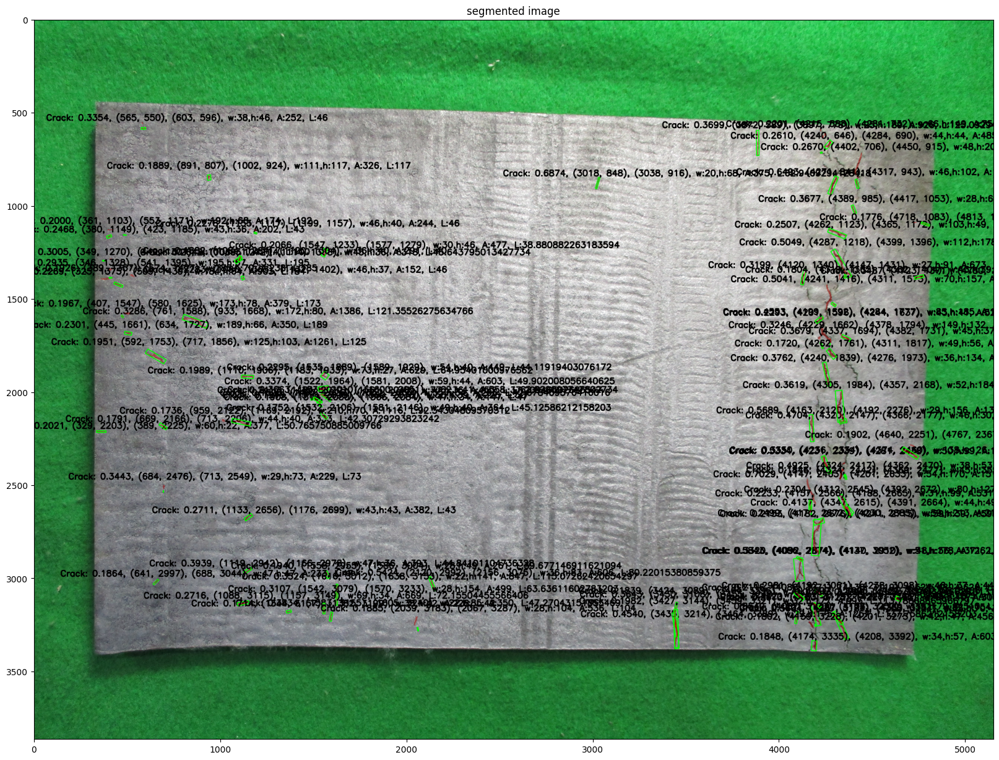

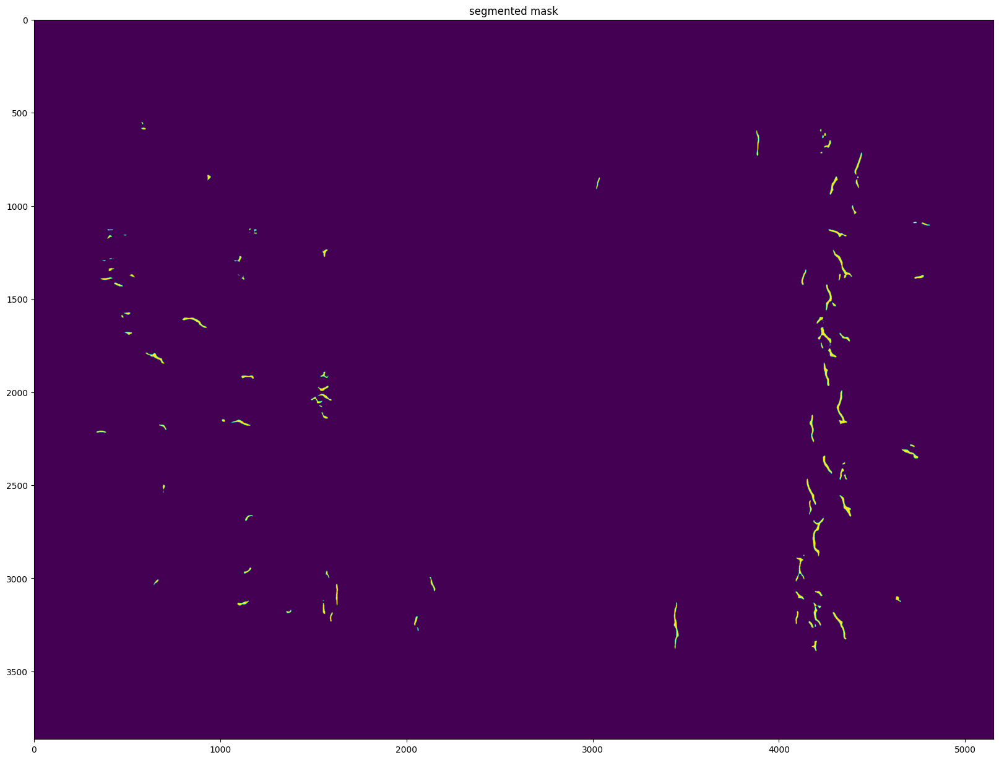

In [148]:
# 결함 분류 기준
# p_list =  [9, 20.8, 33.3, 50, 66.7, 79.2, 91] # Billet 단면 기준
p_list =  [10, 20.8, 40, 50, 60, 79.2, 90] # Bloom 표면 기준
# image_path = 'bloom/블룸표면/125.jpg'
image_path = 'bloom/블룸표면/292.jpg'
# image_path = 'bloom/블룸L방향/163.jpg'
# image_path = 'bloom/빌렛단면/111.JPG'
# image_path = 'bloom/블룸단면/288.jpg'
# image_path = 'result/빌렛BC급/SPS4_B76474_306_좌면.jpg'

Equiaxed_score_threshold = 0.6
crack_score_threshold = 0.3

# print('################## 샘플 분류 모델 ##################')
# img_arr = cv2.imread(f'{image_path}')
# # img_arr = cv2.imread('coco_billet/train/69.png')
# detected_img, total_mask, first_df = get_detected_img(model_ckpt_1, img_arr, color_list=COLORS, Equiaxed_score_threshold=Equiaxed_score_threshold, crack_score_threshold=Equiaxed_score_threshold,  draw_box=True, is_print=True)
# detected_img = cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB)
# plt.figure(figsize=(20,20))
# plt.imshow(detected_img)
# plt.title('segmented image')
# plt.show()
# plt.figure(figsize=(20,20))
# plt.imshow(total_mask)
# plt.title('segmented mask')
# plt.show()

# print('################## 결함 검출 모델 ##################')
# img_arr = cv2.imread(f'{image_path}')
# # img_arr = cv2.imread('coco_billet/train/69.png')
# detected_img, total_mask, second_df = get_detected_img(model_ckpt_2, img_arr, color_list=COLORS, Equiaxed_score_threshold=Equiaxed_score_threshold, crack_score_threshold=crack_score_threshold,  draw_box=True, is_print=True)
# detected_img = cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB)
# plt.figure(figsize=(20,20))
# plt.imshow(detected_img)
# plt.title('segmented image')
# plt.show()
# plt.figure(figsize=(20,20))
# plt.imshow(total_mask)
# plt.title('segmented mask')
# plt.show()

print('################## 이중 판정 모델 ##################')
img_arr = cv2.imread(f'{image_path}')
# print(img_arr.shape)
detected_img, total_mask, data = double_detected_img(model_ckpt_1=model_ckpt_1,
                                                         model_ckpt_2=model_ckpt_2,
                                                         img_arr=img_arr, 
                                                         p_list=p_list,
                                                         color_list=COLORS,
                                                         Equiaxed_score_threshold=0.6,
                                                         crack_score_threshold=0.08, # crack_score_threshold<0.13이면 crack_score_threshold=0.13으로 고정함
                                                         draw_box=True,
                                                         is_print=False,
                                                         save=True)
detected_img = cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(20,20))
plt.imshow(detected_img)
plt.title('segmented image')
plt.show()
plt.figure(figsize=(20,20))
plt.imshow(total_mask)
plt.title('segmented mask')
plt.show()

################## 이중 판정 모델 ##################
[10, 20.8, 40, 50, 60, 79.2, 90]
검출 판정 1번째
Bloom_Side_Surface: 0.9839, (289, 475), (4819, 3406), w:4530,h:2931, A:13045585
[10]
10
Bloom_Side_Surface로 샘플분류완료. 샘플분류에 맞게 2차판정진행
load checkpoint from local path: tutorial_exps/bloom_segment_model/epoch_4464.pth
Crack: 1.0000, (4272, 849), (4314, 938), w:42,h:89, A:1198, L:89.62645721435547
Crack: 1.0000, (4328, 2548), (4376, 2640), w:48,h:92, A:1049, L:93.48258209228516
Crack: 1.0000, (4309, 1985), (4348, 2099), w:39,h:114, A:1144, L:105.16914367675781
Crack: 1.0000, (4148, 2479), (4197, 2618), w:49,h:139, A:1416, L:117.6701889038086
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
Crack: 1.0000, (4249, 1427), (4299, 1556), w:50,h:129, A:1123, L:129
Crack: 1.0000, (4202, 1589), (4241, 1630), w:39,h:41, A:619, L:51.39337921142578
Crack: 0.9999, (4205, 1635), (4269, 1762), w:64,h:127, A:1603, L:95.62178039550781
Crack: 0.9999, (536, 1091), (586, 1127), w:50,h:36, A:409, L:68.45700073242188
컨투어 좌표 4개 이

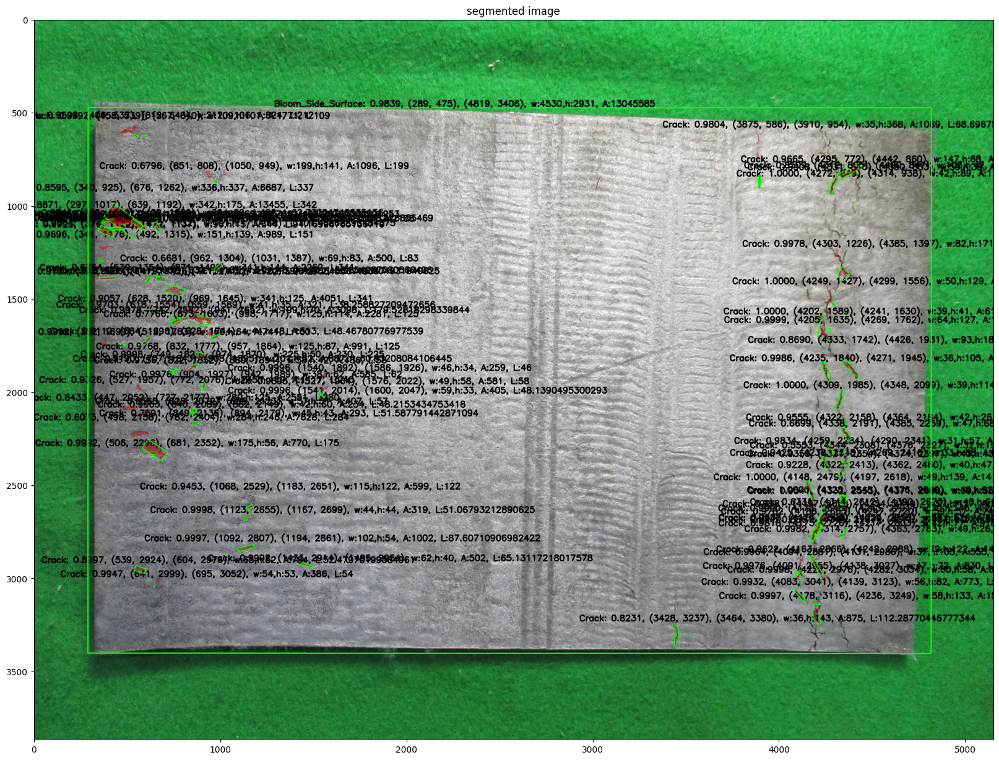

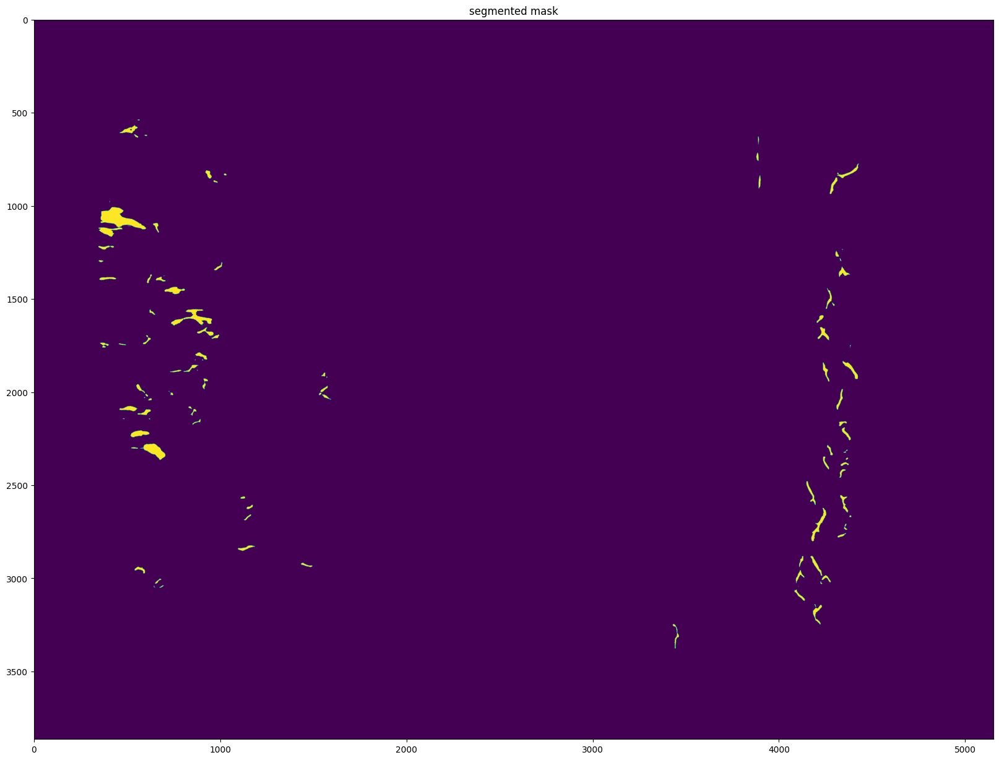

In [145]:
# 결함 분류 기준
# p_list =  [9, 20.8, 33.3, 50, 66.7, 79.2, 91] # Billet 단면 기준
p_list =  [10, 20.8, 40, 50, 60, 79.2, 90] # Bloom 표면 기준
# image_path = 'bloom/블룸표면/125.jpg'
image_path = 'bloom/블룸표면/292.jpg'
# image_path = 'bloom/블룸L방향/163.jpg'
# image_path = 'bloom/빌렛단면/111.JPG'
# image_path = 'bloom/블룸단면/288.jpg'
# image_path = 'result/빌렛BC급/SPS4_B76474_406_좌면.jpg'

Equiaxed_score_threshold = 0.6
crack_score_threshold = 0.3

# print('################## 샘플 분류 모델 ##################')
# img_arr = cv2.imread(f'{image_path}')
# # img_arr = cv2.imread('coco_billet/train/69.png')
# detected_img, total_mask, first_df = get_detected_img(model_ckpt_1, img_arr, color_list=COLORS, Equiaxed_score_threshold=Equiaxed_score_threshold, crack_score_threshold=Equiaxed_score_threshold,  draw_box=True, is_print=True)
# detected_img = cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB)
# plt.figure(figsize=(20,20))
# plt.imshow(detected_img)
# plt.title('segmented image')
# plt.show()
# plt.figure(figsize=(20,20))
# plt.imshow(total_mask)
# plt.title('segmented mask')
# plt.show()

# print('################## 결함 검출 모델 ##################')
# img_arr = cv2.imread(f'{image_path}')
# # img_arr = cv2.imread('coco_billet/train/69.png')
# detected_img, total_mask, second_df = get_detected_img(model_ckpt_2, img_arr, color_list=COLORS, Equiaxed_score_threshold=Equiaxed_score_threshold, crack_score_threshold=crack_score_threshold,  draw_box=True, is_print=True)
# detected_img = cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB)
# plt.figure(figsize=(20,20))
# plt.imshow(detected_img)
# plt.title('segmented image')
# plt.show()
# plt.figure(figsize=(20,20))
# plt.imshow(total_mask)
# plt.title('segmented mask')
# plt.show()

print('################## 이중 판정 모델 ##################')
img_arr = cv2.imread(f'{image_path}')
# print(img_arr.shape)
detected_img, total_mask, data = double_detected_img(model_ckpt_1=model_ckpt_1,
                                                         model_ckpt_2=model_ckpt_2,
                                                         img_arr=img_arr, 
                                                         p_list=p_list,
                                                         color_list=COLORS,
                                                         Equiaxed_score_threshold=0.6,
                                                         crack_score_threshold=0.08, # crack_score_threshold<0.13이면 crack_score_threshold=0.13으로 고정함
                                                         draw_box=True,
                                                         is_print=True,
                                                         save=True)
detected_img = cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(20,20))
plt.imshow(detected_img)
plt.title('segmented image')
plt.show()
plt.figure(figsize=(20,20))
plt.imshow(total_mask)
plt.title('segmented mask')
plt.show()

################## 이중 판정 모델 ##################
[10, 20.8, 40, 50, 60, 79.2, 90]
검출 판정 1번째
[10]
10
Bloom_Side_Surface로 샘플분류완료. 샘플분류에 맞게 2차판정진행
load checkpoint from local path: tutorial_exps/bloom_segment_model/epoch_72.pth
컨투어 좌표 4개 이하
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.
컨투어 없음
컨투어 좌표 4개 이하
해당 범위 내의 타원이 없어 원래 bbox 등가직경 계산방식으로  계산합니다.


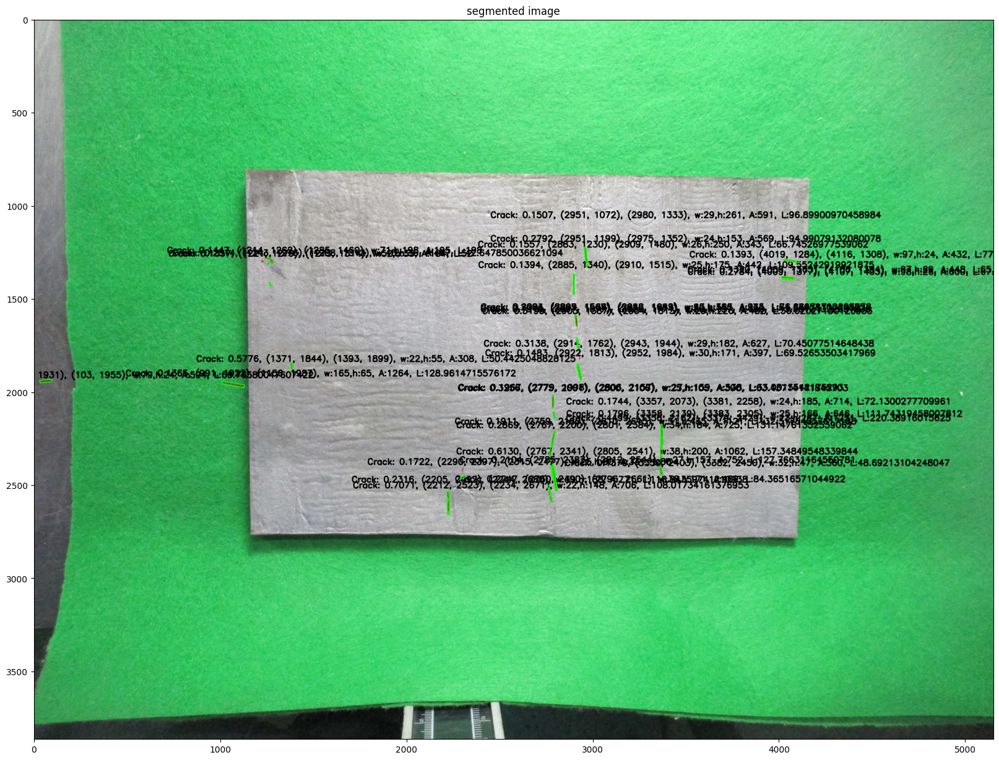

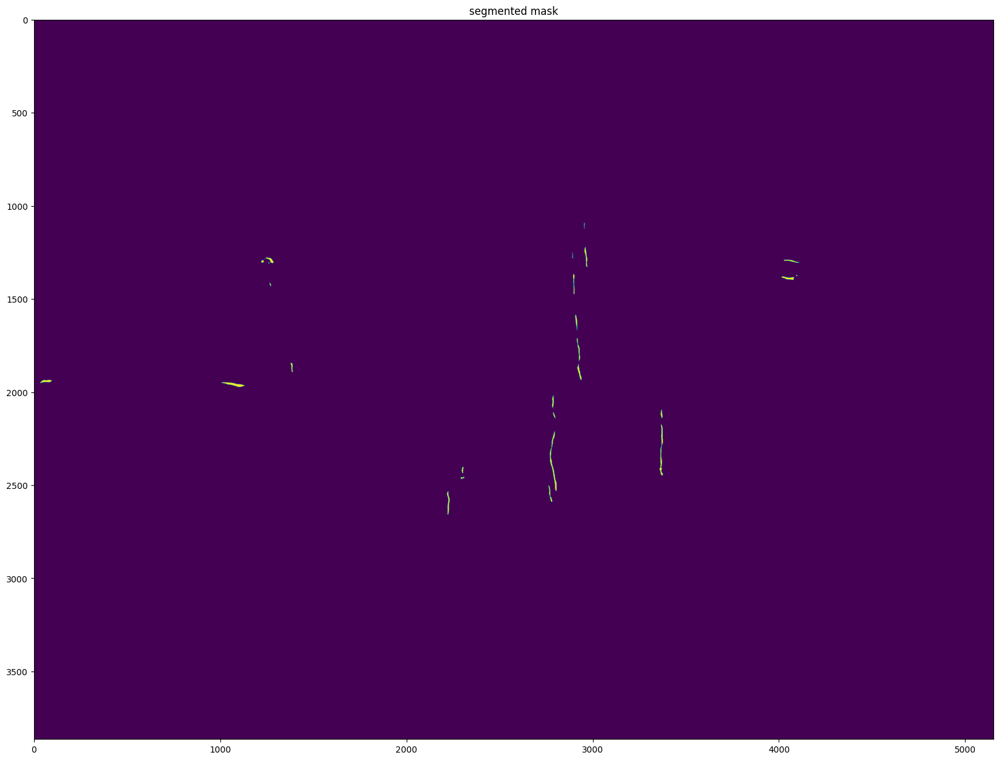

In [94]:
# 결함 분류 기준
# p_list =  [9, 20.8, 33.3, 50, 66.7, 79.2, 91] # Billet 단면 기준
p_list =  [10, 20.8, 40, 50, 60, 79.2, 90] # Bloom 표면 기준
# image_path = 'bloom/블룸표면/125.jpg'
# image_path = 'bloom/블룸표면/292.jpg'
# image_path = 'bloom/블룸L방향/163.jpg'
# image_path = 'bloom/빌렛단면/111.JPG'
# image_path = 'bloom/블룸단면/288.jpg'
image_path = 'result/빌렛BC급/SPS4_B76474_306_좌면.jpg'

Equiaxed_score_threshold = 0.6
crack_score_threshold = 0.3

# print('################## 샘플 분류 모델 ##################')
# img_arr = cv2.imread(f'{image_path}')
# # img_arr = cv2.imread('coco_billet/train/69.png')
# detected_img, total_mask, first_df = get_detected_img(model_ckpt_1, img_arr, color_list=COLORS, Equiaxed_score_threshold=Equiaxed_score_threshold, crack_score_threshold=Equiaxed_score_threshold,  draw_box=True, is_print=True)
# detected_img = cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB)
# plt.figure(figsize=(20,20))
# plt.imshow(detected_img)
# plt.title('segmented image')
# plt.show()
# plt.figure(figsize=(20,20))
# plt.imshow(total_mask)
# plt.title('segmented mask')
# plt.show()

# print('################## 결함 검출 모델 ##################')
# img_arr = cv2.imread(f'{image_path}')
# # img_arr = cv2.imread('coco_billet/train/69.png')
# detected_img, total_mask, second_df = get_detected_img(model_ckpt_2, img_arr, color_list=COLORS, Equiaxed_score_threshold=Equiaxed_score_threshold, crack_score_threshold=crack_score_threshold,  draw_box=True, is_print=True)
# detected_img = cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB)
# plt.figure(figsize=(20,20))
# plt.imshow(detected_img)
# plt.title('segmented image')
# plt.show()
# plt.figure(figsize=(20,20))
# plt.imshow(total_mask)
# plt.title('segmented mask')
# plt.show()

print('################## 이중 판정 모델 ##################')
img_arr = cv2.imread(f'{image_path}')
# print(img_arr.shape)
detected_img, total_mask, data = double_detected_img(model_ckpt_1=model_ckpt_1,
                                                         model_ckpt_2=model_ckpt_2,
                                                         img_arr=img_arr, 
                                                         p_list=p_list,
                                                         color_list=COLORS,
                                                         Equiaxed_score_threshold=0.6,
                                                         crack_score_threshold=0.08, # crack_score_threshold<0.13이면 crack_score_threshold=0.13으로 고정함
                                                         draw_box=True,
                                                         is_print=False,
                                                         save=True)
detected_img = cv2.cvtColor(detected_img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(20,20))
plt.imshow(detected_img)
plt.title('segmented image')
plt.show()
plt.figure(figsize=(20,20))
plt.imshow(total_mask)
plt.title('segmented mask')
plt.show()

In [14]:
data.head(10)

,class,surface_crack,Position_number,Position,class_kind,IoU_Confidence_Score,left,top,right,bottom,width,height,area,bbox_angle,mask_angle,equvalant_size,crack_length,Area_ratio%,Equiaxed_Area_ratio%,Distance_from_surface,Distance_from_side,L_shrinkage_size,top_dendrite_length,left_ratio,right_ratio,top_ratio,bottom_ratio,centerX_ratio,centerY_ratio
0,Crack,transverse,7.0,bottom_nearcorner,transverse,0.891513,4088,3176,4105,3251,17,75,485.0,12.771243,81.027373,24.849973,70.720154,None,None,NaN,731,None,None,83.863135,84.238411,92.152849,94.711702,84.050773,93.432276
1,Crack,transverse,7.0,bottom_nearcorner,transverse,0.737209,4165,2123,4193,2272,28,149,1253.0,10.642871,86.134544,39.942072,137.277893,None,None,NaN,654,None,None,85.562914,86.181015,56.226544,61.310133,85.871965,58.768338
2,Crack,transverse,5.0,face,transverse,0.702593,3019,849,3037,915,18,66,337.5,15.255119,75.173521,20.729649,64.033447,None,None,NaN,1800,None,None,60.264901,60.662252,12.760150,15.011941,60.463576,13.886046
3,Crack,transverse,7.0,bottom_nearcorner,transverse,0.699484,4147,2466,4200,2629,53,163,1570.0,18.012109,68.702644,44.710022,163.000000,None,None,NaN,672,None,None,85.165563,86.335541,67.929034,73.490276,85.750552,70.709655
4,Crack,transverse,2.0,top_nearcorner,transverse,0.669546,1168,3158,1189,3217,21,59,547.5,19.592282,85.426079,26.402626,49.720932,None,None,NaN,900,None,None,19.403974,19.867550,91.538724,93.551689,19.635762,92.545206
5,Crack,intergranular,7.0,bottom_nearcorner,intergranular,0.614220,4272,846,4316,942,44,96,1062.0,24.623565,69.102236,36.772006,94.292793,None,None,NaN,547,None,None,87.924945,88.896247,12.657796,15.933129,88.410596,14.295462
6,Crack,intergranular,7.0,bottom_nearcorner,intergranular,0.575181,4231,2340,4281,2439,50,99,1086.0,26.796081,68.818649,37.185187,95.832146,None,None,NaN,588,None,None,87.019868,88.123620,63.630160,67.007847,87.571744,65.319004
7,Crack,transverse,6.0,bottom_face,transverse,0.557734,3432,3217,3461,3391,29,174,1192.5,9.462322,87.251907,38.965859,126.303589,None,None,NaN,1387,None,None,69.381898,70.022075,93.551689,99.488229,69.701987,96.519959
8,Crack,intergranular,7.0,bottom_nearcorner,intergranular,0.557545,4320,2147,4367,2176,47,29,548.5,58.324531,0.0,26.426727,44.524467,None,None,NaN,499,None,None,88.984547,90.022075,57.045377,58.034800,89.503311,57.540089
9,Crack,intergranular,7.0,bottom_nearcorner,intergranular,0.543169,4324,2416,4362,2470,38,54,669.0,35.134193,65.897766,29.185566,54.000000,None,None,NaN,495,None,None,89.072848,89.911700,66.223132,68.065507,89.492274,67.144319


In [274]:
data

,class,surface_crack,Position_number,Position,class_kind,IoU_Confidence_Score,left,top,right,bottom,width,height,area,bbox_angle,mask_angle,equvalant_size,crack_length,Area_ratio%,Equiaxed_Area_ratio%,Distance_from_surface,Distance_from_side,L_shrinkage_size,top_dendrite_length,left_ratio,right_ratio,top_ratio,bottom_ratio,centerX_ratio,centerY_ratio
0,Crack,None,8.0,top_left,hinge,0.896265,1369,524,1392,606,23,82,429,75.17352,9.24493,20.712315,82,0.003698,25.033384,264,524,38.0,875,14.285714,14.941545,7.751028,10.158544,14.613630,8.954786
1,Crack,None,44.0,right_bottom,hinge,0.877475,4198,3168,4305,3188,107,20,611,9.283553,5.708906,24.718414,107,0.005267,25.033384,70,177,38.0,875,94.952951,98.003992,85.378743,85.965942,96.478472,85.672343
2,Crack,None,39.0,bottom_left,hinge,0.855381,1972,2700,2042,2738,70,38,648,28.551392,10.911127,25.455844,70,0.005586,25.033384,928,1174,38.0,875,31.479897,33.475905,71.638285,72.753964,32.477901,72.196124
3,Crack,None,39.0,bottom_left,hinge,0.836040,1781,2794,1934,2927,153,133,2837,39.805571,9.029912,53.263496,153,0.024456,25.033384,739,1066,38.0,875,26.033647,30.396350,74.398121,78.302995,28.214999,76.350558
4,Crack,None,7.0,left_top,hinge,0.827568,995,816,1051,836,56,20,373,16.798372,13.72049,19.313208,56,0.003215,25.033384,127,183,38.0,875,3.621329,5.218135,16.324134,16.911333,4.419732,16.617733
5,Crack,None,45.0,bottom_left,hinge,0.807047,1496,3104,1618,3474,122,370,11934,74.871798,8.74031,109.242849,370,0.102874,25.033384,192,750,38.0,875,17.907043,21.385800,83.499706,94.362889,19.646421,88.931298
6,Crack,None,12.0,top_right,midway2,0.753298,3236,414,3822,1190,586,776,16579,65.915767,9.22825,128.759466,776,0.142916,25.033384,154,1139,38.0,875,67.522099,84.231537,4.521433,27.304756,75.876818,15.913095
7,Crack,None,7.0,left_top,hinge,0.699264,997,738,1053,760,56,22,162,15.945396,76.039948,12.727922,56,0.001396,25.033384,129,185,38.0,875,3.678358,5.275164,14.034058,14.679977,4.476761,14.357017
8,Crack,None,7.0,left_top,hinge,0.655699,990,747,1051,768,61,21,214,18.034286,76.047315,14.628739,61,0.001845,25.033384,122,183,38.0,875,3.478757,5.218135,14.298297,14.914856,4.348446,14.606577
9,Crack,None,39.0,bottom_left,hinge,0.490032,1772,2897,1826,2926,54,29,394,28.767649,18.99595,19.849433,54,0.003396,25.033384,740,958,38.0,875,25.777017,27.316795,77.422196,78.273635,26.546906,77.847915


/tmp/ipykernel_1269/635215667.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Position'] = data['Position'].astype('category').cat.codes
/tmp/ipykernel_1269/635215667.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['class_kind'] = data['class_kind'].astype('category').cat.codes
/tmp/ipykernel_1269/635215667.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

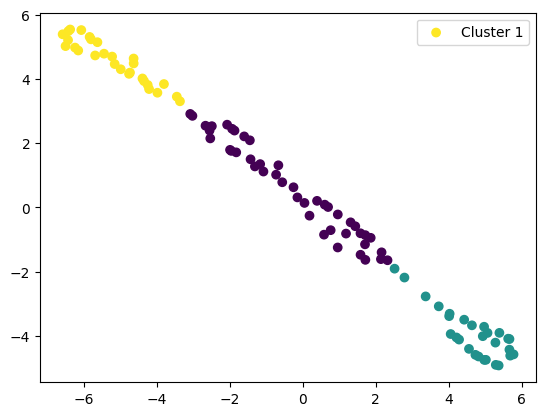

In [243]:
def kmean_crack_classification(data):    
    import pandas as pd
    import numpy as np
    from sklearn.manifold import TSNE
    from sklearn.cluster import KMeans
    import matplotlib.pyplot as plt

    # 문자열 데이터를 숫자로 변환
    data['Position'] = data['Position'].astype('category').cat.codes
    data['class_kind'] = data['class_kind'].astype('category').cat.codes
    data['class'] = data['class'].astype('category').cat.codes

    # 모든 행이 NaN인 열을 제외한 DataFrame을 반환
    all_nan_columns = [col for col in data.columns if data[col].isnull().all()]
    data = data.drop(all_nan_columns, axis=1)

    # Area_ratio%와 equvalant_size 열 정규화
    data['Area_ratio%'] = (data['Area_ratio%'] - data['Area_ratio%'].mean()) / data['Area_ratio%'].std()
    data['equvalant_size'] = (data['equvalant_size'] - data['equvalant_size'].mean()) / data['equvalant_size'].std()

    # t-SNE 알고리즘을 사용하여 데이터를 2D 공간에 시각화
    tsne = TSNE(n_components=2, random_state=0, perplexity=30)
    X_tsne = tsne.fit_transform(data)

    # k-means 알고리즘을 사용하여 군집 생성
    kmeans = KMeans(n_clusters=3, random_state=0)
    clusters = kmeans.fit_predict(data)

    # 군집 시각화
    plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=clusters)
    plt.legend(['Cluster 1', 'Cluster 2', 'Cluster 3'])
    plt.show()

kmean_crack_classification(data[(data['class'] == 'Crack')])


# 정답지

35 <class 'str'>
bloom/images/241.jpg
bloom/images/241.jpg
bloom/images/241.jpg
bloom/images/241.jpg


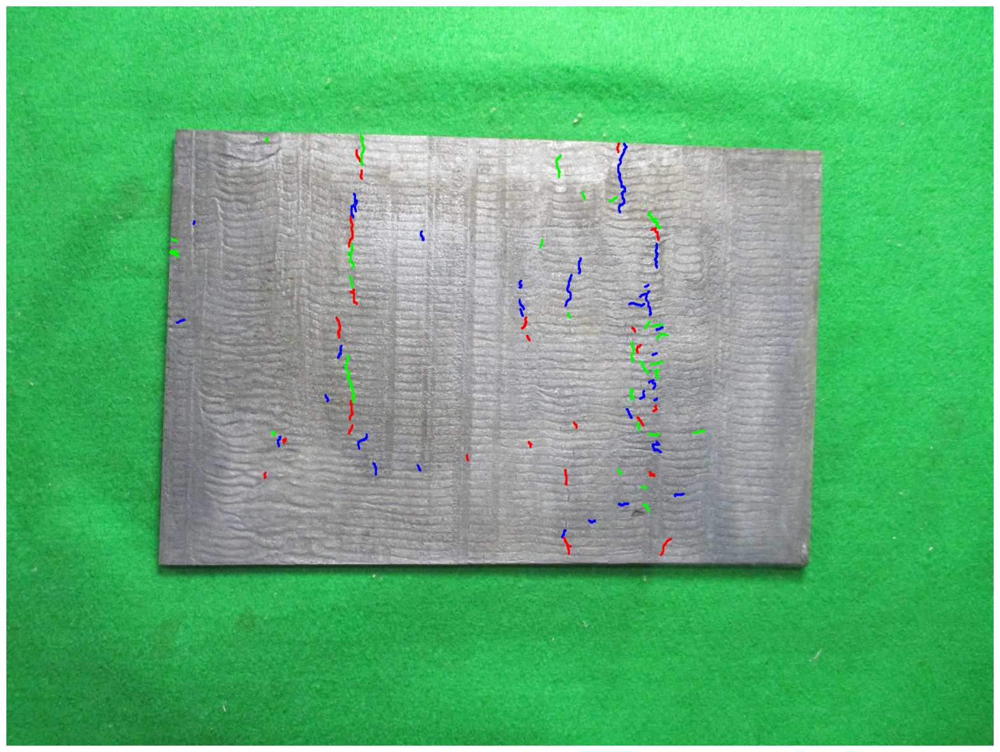

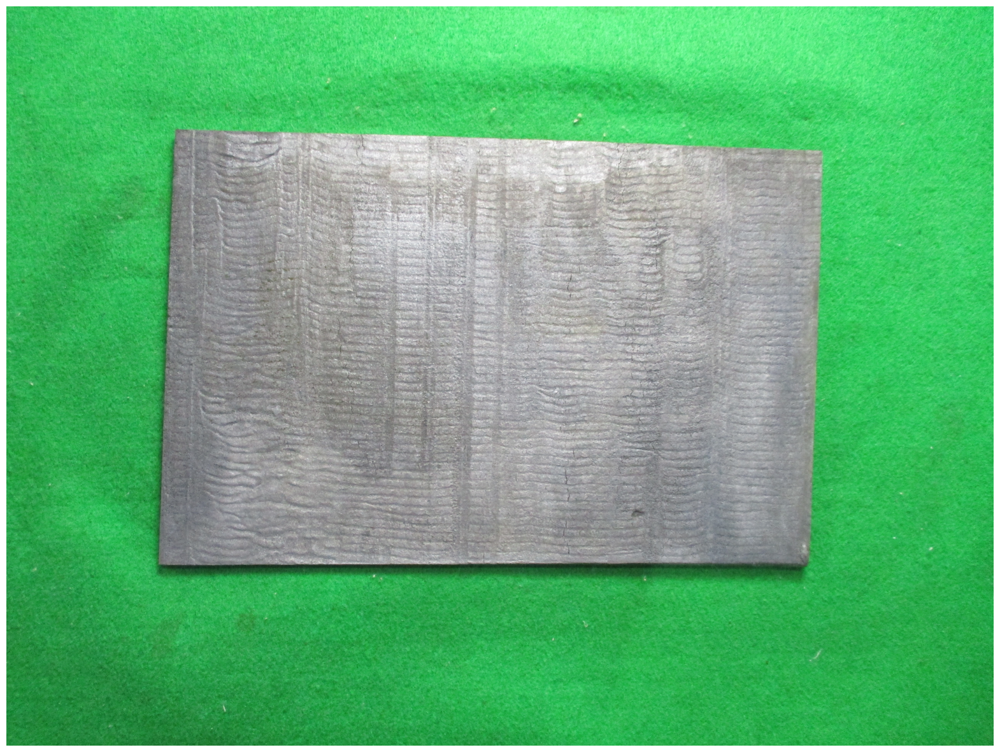

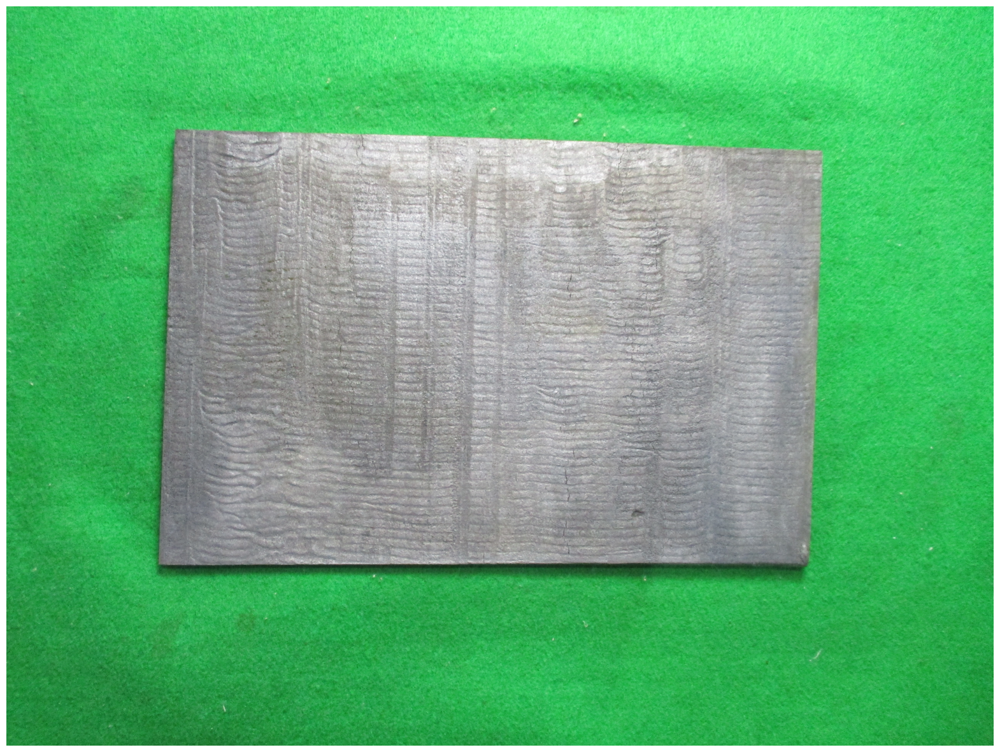

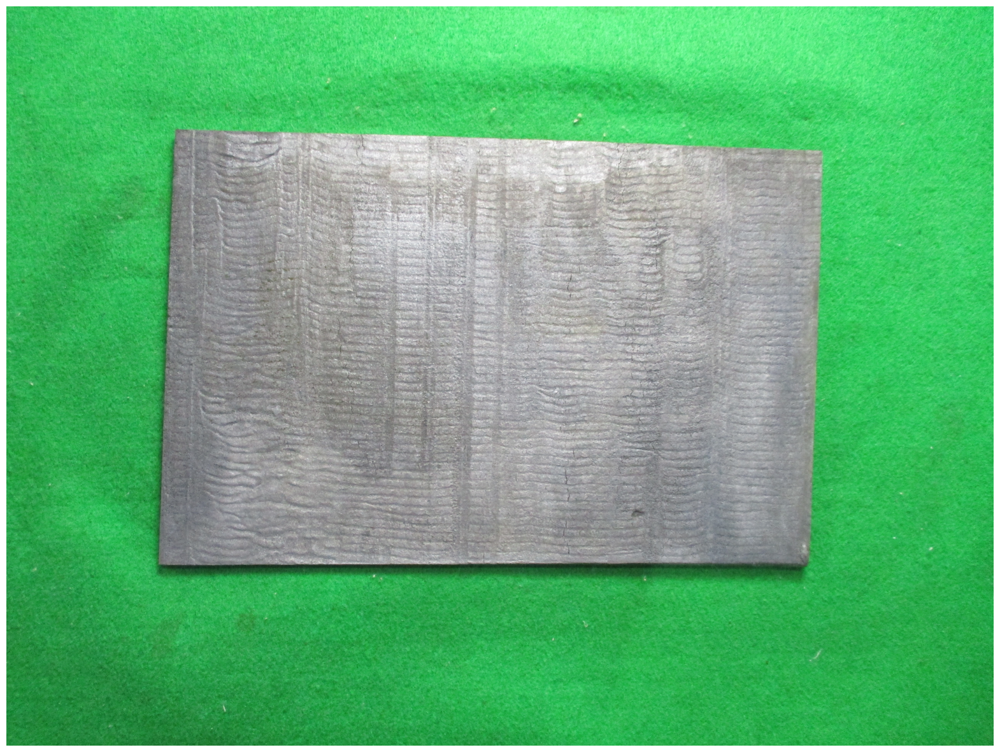

In [74]:
import matplotlib.pyplot as plt
import cv2
idx = 241
# cls = 0
# 원본 이미지 시각화 
# val_image_id = str(val_df['image_id'].iloc[idx])
train_image_id = str(train_df[train_df['image_id'].values == idx].index[0])
print(train_image_id, type(train_image_id))
for c in range(4):
    # annIds = coco_train.getAnnIds(imgIds=train_image_id, catIds=c, iscrowd=None)
    annIds = coco_train.getAnnIds(imgIds=[str(idx)], catIds=[c], iscrowd=None)
    
    anns = coco_train.loadAnns(annIds)
    # segmentation 정보만 별도로 추출. 
    # 모든 세포 좌표에 대한 list 생성
    ann_seg_list = [ann['segmentation'][0] for ann in anns]
    train_image_name = train_df[train_df.index == train_df[train_df['image_id'].values == idx].index[0]]['image_name'].tolist()
    
    # train_image_name = train_df[train_df.index == train_df[train_df['image_id'].values == idx].index[0]]['image_name'].tolist()
    print(train_image_name[0])
    image_array = cv2.cvtColor(cv2.imread(train_image_name[0]), cv2.COLOR_BGR2RGB)

    # coco segmentation 정보를 기반으로 segmentation 적용한 이미지 시각화 
    masked_image = draw_segment(image_array, ann_seg_list, color_list, alpha=0.6)
    
    plt.figure(figsize=(20,20))
    plt.imshow(masked_image)
    plt.axis('off')

In [25]:
val_df['image_id'].values

array([136, 227, 254, 252, 295, 158, 283, 247, 231])

In [26]:
import matplotlib.pyplot as plt
import cv2
idx = 279
# cls = 0
# 원본 이미지 시각화 
# val_image_id = str(val_df['image_id'].iloc[idx])
val_image_id = str(val_df[val_df['image_id'].values == idx].index[0])
print(val_image_id, type(val_image_id))
for c in range(4):
    annIds = coco_val.getAnnIds(imgIds=[str(idx)], catIds=[c], iscrowd=None)
    anns = coco_val.loadAnns(annIds)
    # segmentation 정보만 별도로 추출. 
    # 모든 세포 좌표에 대한 list 생성
    ann_seg_list = [ann['segmentation'][0] for ann in anns]
    val_image_name = val_df[val_df.index == val_df[val_df['image_id'].values == idx].index[0]]['image_name'].tolist()
    
    # train_image_name = train_df[train_df.index == train_df[train_df['image_id'].values == idx].index[0]]['image_name'].tolist()
    print(val_image_name[0])
    image_array = cv2.cvtColor(cv2.imread(val_image_name[0]), cv2.COLOR_BGR2RGB)

    # coco segmentation 정보를 기반으로 segmentation 적용한 이미지 시각화 
    masked_image = draw_segment(image_array, ann_seg_list, color_list, alpha=0.6)
    
    plt.figure(figsize=(20,20))
    plt.imshow(masked_image)
    plt.axis('off')

IndexError: index 0 is out of bounds for axis 0 with size 0

### 블룸 표면마크로 크랙형상분류 알고리즘 개발

3507 3406
billet_0.png: intergranular_crack, bbox_angle: 44, mask_angle: 0


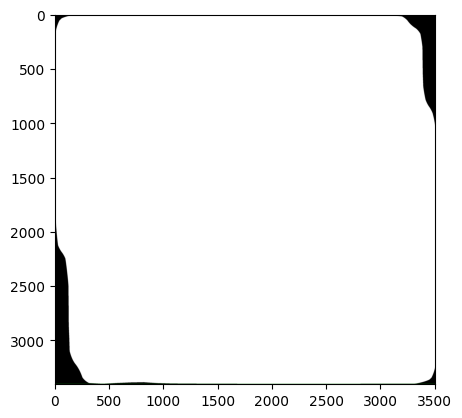

23 82
Crack_0.png: longitudnal_crack, bbox_angle: 74, mask_angle: 82


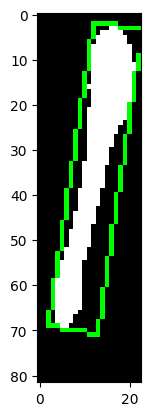

107 20
Crack_1.png: transverse_crack, bbox_angle: 11, mask_angle: 9


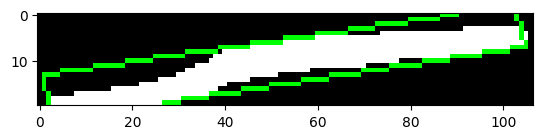

33 31
Crack_10.png: intergranular_crack, bbox_angle: 43, mask_angle: 43


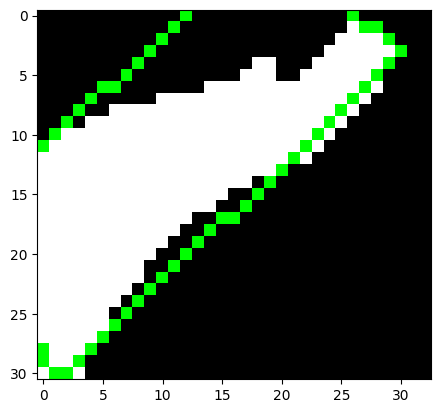

37 28
Crack_11.png: intergranular_crack, bbox_angle: 37, mask_angle: 0


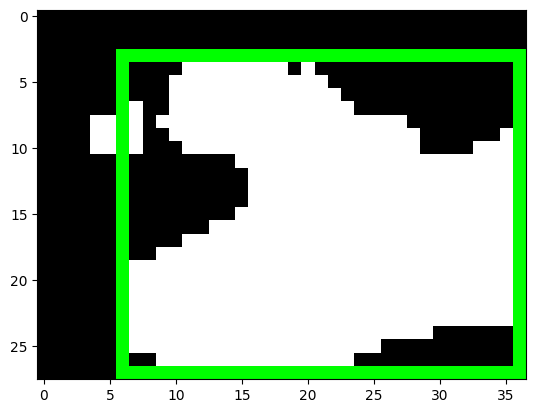

23 63
Crack_12.png: longitudnal_crack, bbox_angle: 70, mask_angle: 82


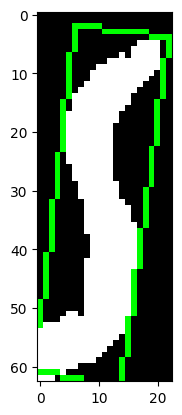

34 33
Crack_13.png: intergranular_crack, bbox_angle: 44, mask_angle: 46


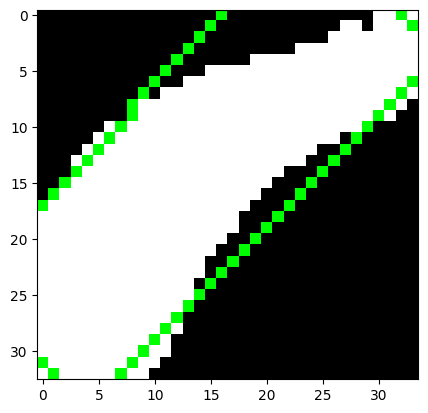

24 85
Crack_14.png: longitudnal_crack, bbox_angle: 74, mask_angle: 74


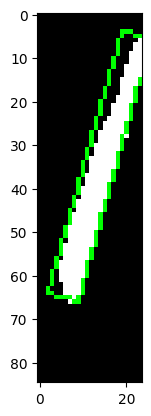

95 62
Crack_15.png: intergranular_crack, bbox_angle: 33, mask_angle: 29


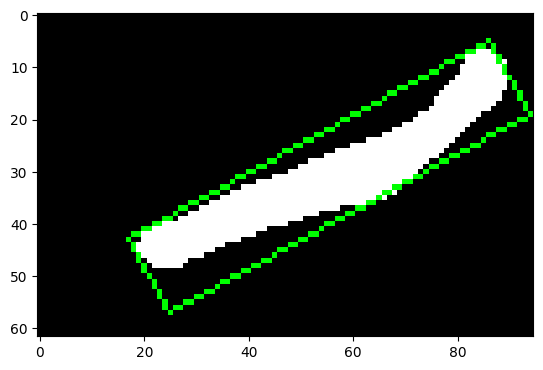

50 30
Crack_16.png: intergranular_crack, bbox_angle: 31, mask_angle: 22


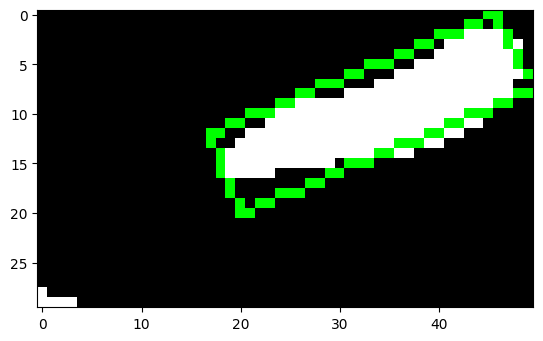

123 42
Crack_17.png: transverse_crack, bbox_angle: 19, mask_angle: 12


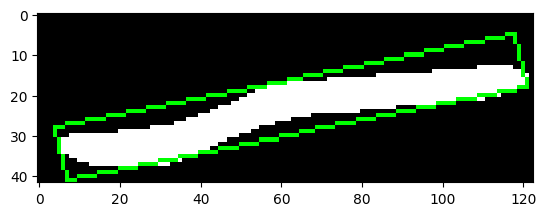

69 20
Crack_18.png: transverse_crack, bbox_angle: 16, mask_angle: 3


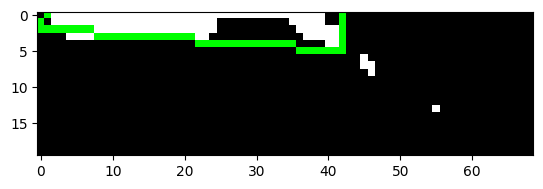

127 115
Crack_19.png: intergranular_crack, bbox_angle: 42, mask_angle: 43


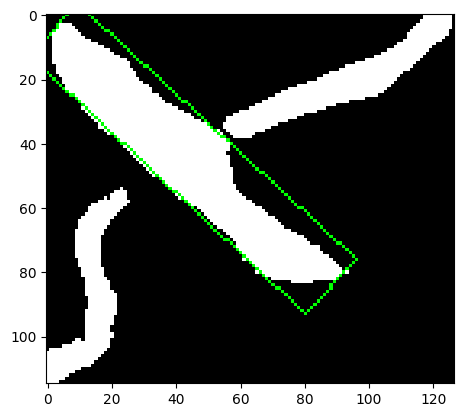

70 38
Crack_2.png: intergranular_crack, bbox_angle: 28, mask_angle: 27


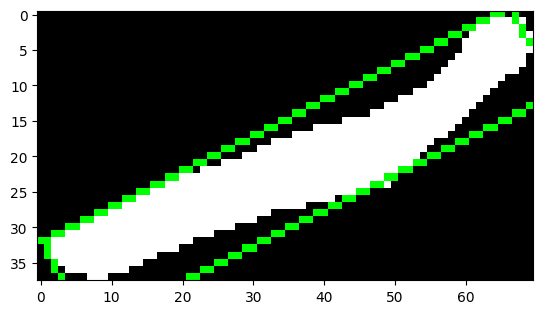

67 18
Crack_20.png: transverse_crack, bbox_angle: 15, mask_angle: 10


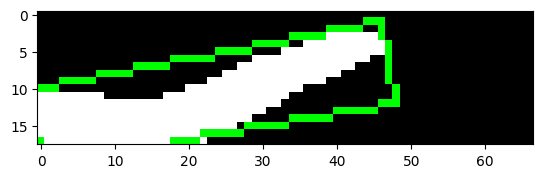

460 412
Crack_21.png: intergranular_crack, bbox_angle: 42, mask_angle: 42


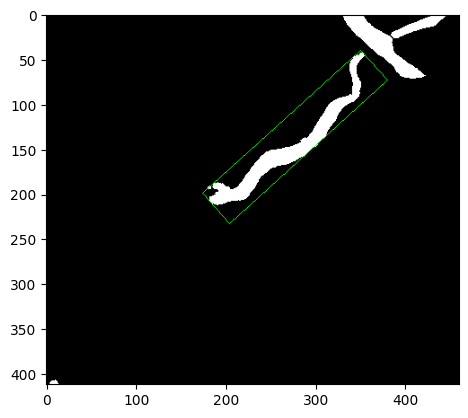

28 63
Crack_22.png: longitudnal_crack, bbox_angle: 66, mask_angle: 77


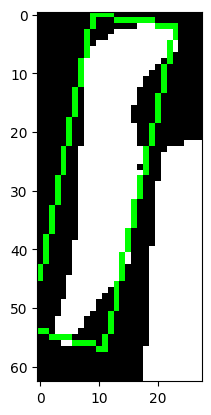

134 151
Crack_23.png: intergranular_crack, bbox_angle: 48, mask_angle: 50


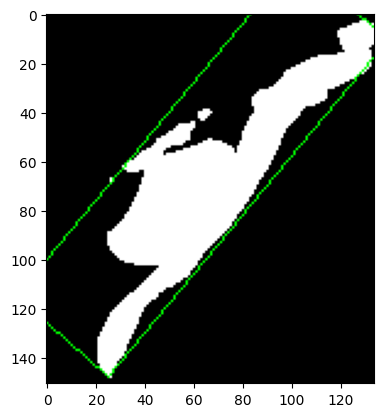

35 150
Crack_24.png: longitudnal_crack, bbox_angle: 77, mask_angle: 90


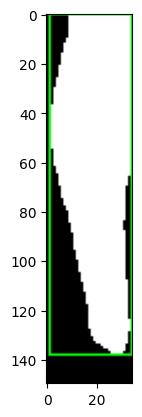

32 33
Crack_25.png: intergranular_crack, bbox_angle: 46, mask_angle: 47


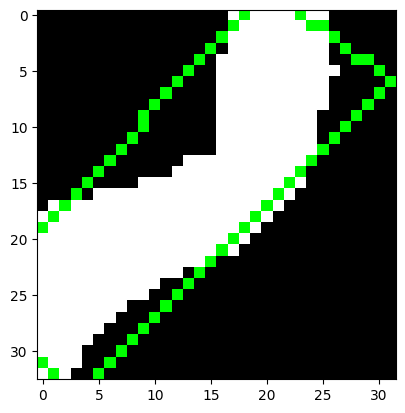

58 25
Crack_26.png: intergranular_crack, bbox_angle: 23, mask_angle: 27


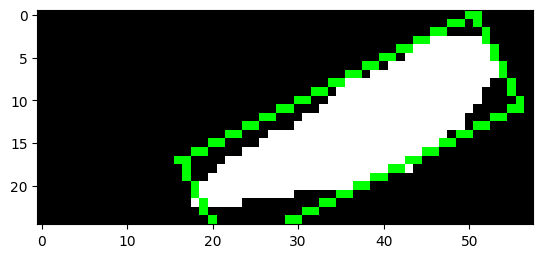

30 53
Crack_27.png: longitudnal_crack, bbox_angle: 60, mask_angle: 90


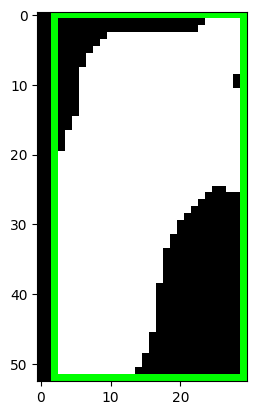

27 56
Crack_28.png: longitudnal_crack, bbox_angle: 64, mask_angle: 66


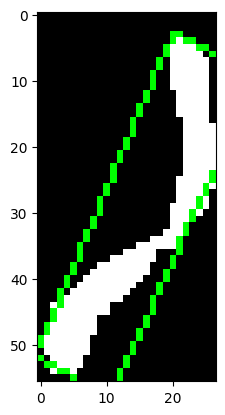

20 84
Crack_29.png: longitudnal_crack, bbox_angle: 77, mask_angle: 83


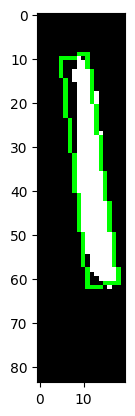

153 133
Crack_3.png: intergranular_crack, bbox_angle: 41, mask_angle: 37


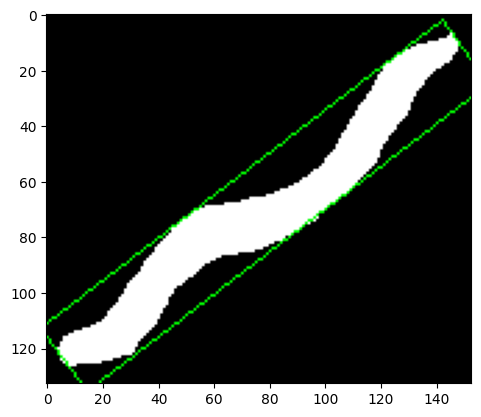

63 27
Crack_30.png: intergranular_crack, bbox_angle: 23, mask_angle: 0


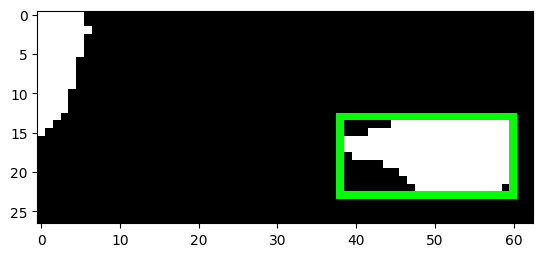

61 61
Crack_31.png: intergranular_crack, bbox_angle: 45, mask_angle: 40


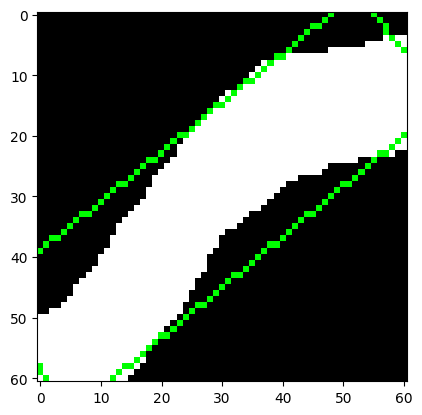

56 20
Crack_4.png: transverse_crack, bbox_angle: 20, mask_angle: 6


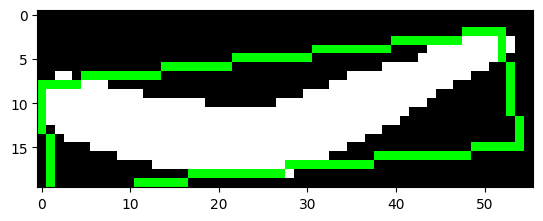

122 370
Crack_5.png: longitudnal_crack, bbox_angle: 72, mask_angle: 76


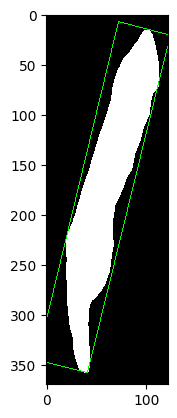

586 776
Crack_6.png: intergranular_crack, bbox_angle: 53, mask_angle: 71


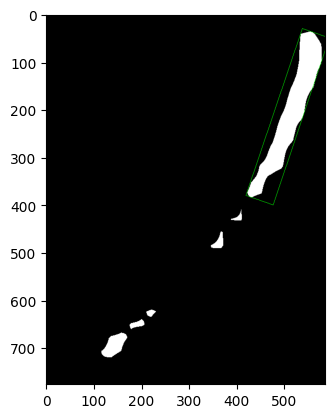

56 22
Crack_7.png: intergranular_crack, bbox_angle: 21, mask_angle: 11


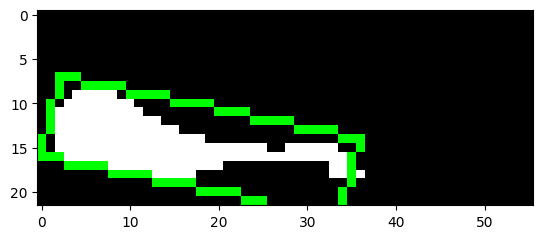

61 21
Crack_8.png: transverse_crack, bbox_angle: 19, mask_angle: 5


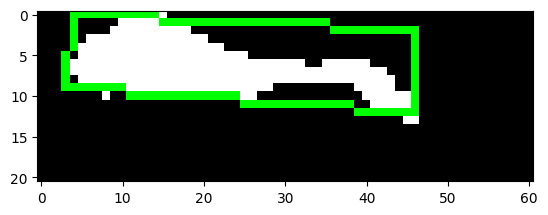

54 29
Crack_9.png: intergranular_crack, bbox_angle: 28, mask_angle: 28


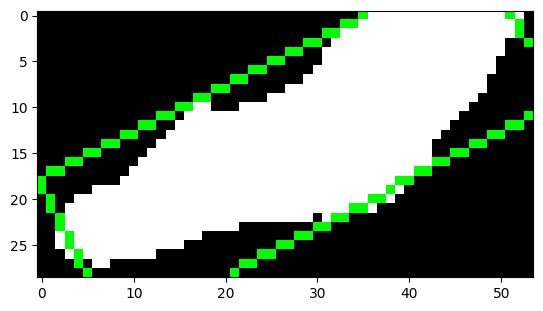

2034 1677
Equiaxed_Area_0.png: intergranular_crack, bbox_angle: 40, mask_angle: 1


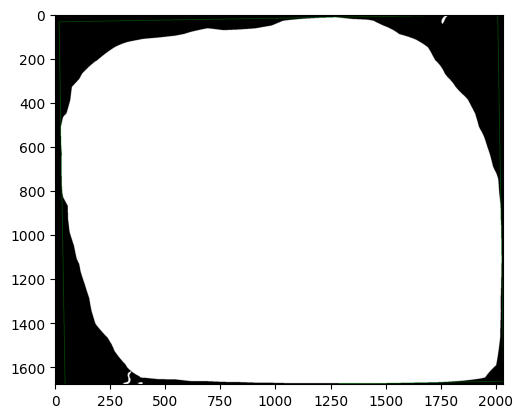

38 30
Shrinkage_0.png: intergranular_crack, bbox_angle: 38, mask_angle: 0


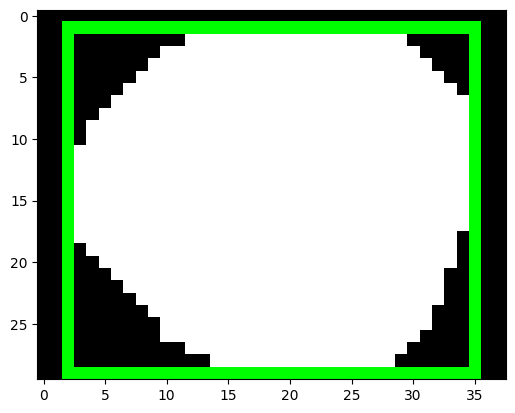

In [29]:
import math
import numpy as np
import cv2

def classify_crack(img):
    crack_class = 'unknown'
    contours, _ = cv2.findContours(img, cv2.RETR_TREE, cv2.CHAIN_APPROX_TC89_KCOS)
    
    # 외곽선 중 가장 큰 외곽선 선택
    max_contour = max(contours, key=cv2.contourArea)
    rect = cv2.minAreaRect(max_contour)
    box = cv2.boxPoints(rect).astype(int)
    x, y, w, h = cv2.boundingRect(max_contour)
    # print(img.shape)
    w, h = img.shape[1], img.shape[0]
    
    # Bounding box 및 mask angle 계산
    bbox_angle = calc_degree(w, h)
    
    if rect[1][0] < rect[1][1]:
        mask_angle = abs(rect[2] - 90)
    else:
        mask_angle = abs(rect[2])
       
    # mask_h, mask_w = rect[1]
    # print(int(np.round(mask_w,0)), int(np.round(mask_h,0)), rect)
    # mask_angle = calc_degree(mask_w, mask_h)
    
    if abs(bbox_angle) > 60 and abs(bbox_angle) <= 90:
        if abs(mask_angle) > 20 and abs(mask_angle) <= 60:
            crack_class = 'intergranular_crack'
        else:
            crack_class = 'longitudnal_crack'
    elif abs(bbox_angle) <= 20:
        if abs(mask_angle) > 20 and abs(mask_angle) <= 60:
            crack_class = 'intergranular_crack'
        else:
            crack_class = 'transverse_crack'
    elif abs(bbox_angle) > 20 and abs(bbox_angle) <= 60:
        if abs(mask_angle) > 80 and abs(mask_angle) <= 90:
            crack_class = 'longitudnal_crack'
        else:
            crack_class = 'intergranular_crack'
    
    result = {
        'crack_class': crack_class,
        'bbox_angle': bbox_angle,
        'mask_angle': mask_angle,
        'box': box,
        'img': img,
        'x': x,
        'y': y,
        'w': w,
        'h': h,
        'rect': rect
    }
    
    return result

def calc_degree(width, height):
    """Bounding box 및 mask angle을 계산하여 degree로 반환합니다."""
    angle = math.atan2(height, width) * 180 / np.pi
    return angle

# 이미지 파일 경로
dir_path = "tutorial_exps/bloom_segment_model/객체모음집/CROP_MASK/"
file_names = os.listdir(dir_path)

# # 한개 이미지 분류하기
# img_path = 'tutorial_exps/bloom_segment_model/객체모음집/CROP_MASK/Crack_0.png'
# img = cv2.imread(img_path)
# gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
# print(img.shape, gray.shape)
# result = classify_crack(gray)
# print(f"{file_name}: {result['crack_class']}, bbox_angle: {int(round(result['bbox_angle'], 0))}, mask_angle: {int(round(result['bbox_angle'], 0))}")
# # draw_img = cv2.rectangle(result[2], (x,y), (x+w, y+h), color=(0,255,0), thickness=1)
# # draw_img = cv2.drawContours(result['img'], [result['box']], 0, color=(0,255,0), thickness=1)

# draw_img = cv2.drawContours(cv2.cvtColor(result['img'], cv2.COLOR_GRAY2BGR), [result['box']], 0, color=(0,255,0), thickness=1)

# # draw_img = cv2.ellipse(result[2], result[1], (0, 128, 0), 1)

# plt.imshow(cv2.cvtColor(draw_img, cv2.COLOR_BGR2RGB))
# plt.show()


# 모든 이미지 분류하기
for file_name in file_names:
    if "Bloom" in file_name:
        continue
    img_path = os.path.join(dir_path, file_name)
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    print(gray.shape[1], gray.shape[0])
    result = classify_crack(gray)
    print(f"{file_name}: {result['crack_class']}, bbox_angle: {int(round(result['bbox_angle'], 0))}, mask_angle: {int(round(result['mask_angle'], 0))}")
    # draw_img = cv2.rectangle(result[2], (x,y), (x+w, y+h), color=(0,255,0), thickness=1)
    # draw_img = cv2.drawContours(result['img'], [result['box']], 0, color=(0,255,0), thickness=1)
    
    draw_img = cv2.drawContours(cv2.cvtColor(result['img'], cv2.COLOR_GRAY2BGR), [result['box']], 0, color=(0,255,0), thickness=1)

    # draw_img = cv2.ellipse(result[2], result[1], (0, 128, 0), 1)

    plt.imshow(cv2.cvtColor(draw_img, cv2.COLOR_BGR2RGB))
    plt.show()